In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
import tensorflow as tf
import numpy as np
import math
import matplotlib
#matplotlib.use("Agg")
import matplotlib.image as mpimg
import matplotlib.gridspec as gridspec
import glob
from data_utils import load_data, augment_data,normalise_train,normalise_test,rgb2gray,rgb2lab,lab2rgb
import matplotlib.pyplot as plt
from tucha import complex_pokemon_model,baselinish,simpler_model,baselinish2,complex_pokemon_model2,baselinish3

from cs231n.data_utils import load_CIFAR10

In [2]:
def show_images(images):
    images = np.reshape(images, [images.shape[0], -1,3])
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg,3]))
    return

In [3]:
def show_images2(images):
    images = np.reshape(images, [images.shape[0], -1])
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg]),cmap = plt.get_cmap('gray'))
    return

Training data shape:  (50000, 32, 32, 3)
Test data shape:  (10000, 32, 32, 3)


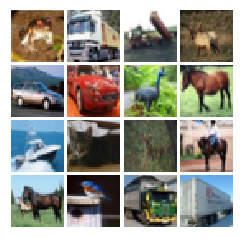

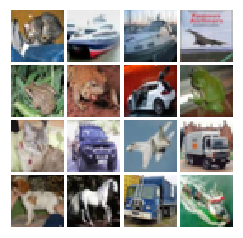

In [4]:
# Load the raw CIFAR-10 data.
from skimage import img_as_float
cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)

# As a sanity check, we print out the size of the training and test data.
print('Training data shape: ', X_train.shape)
print('Test data shape: ', X_test.shape)
X_train = img_as_float(X_train.astype('uint8'))
X_test = img_as_float(X_test.astype('uint8'))
X_train = X_train.astype('float32')
X_test = X_test.astype('float32')
show_images(X_train[:16])
show_images(X_test[:16])

In [5]:
def leaky_relu(x, alpha=0.01):
    """Compute the leaky ReLU activation function.
    
    Inputs:
    - x: TensorFlow Tensor with arbitrary shape
    - alpha: leak parameter for leaky ReLU
    
    Returns:
    TensorFlow Tensor with the same shape as x
    """
    # TODO: implement leaky ReLU
    return tf.maximum(alpha*x,x)

In [6]:
def get_solvers(learning_rate=1e-3, beta1=0.5):
    """Create solvers for GAN training.
    
    Inputs:
    - learning_rate: learning rate to use for both solvers
    - beta1: beta1 parameter for both solvers (first moment decay)
    
    Returns:
    - D_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    - G_solver: instance of tf.train.AdamOptimizer with correct learning_rate and beta1
    """
    D_solver = None
    G_solver = None
    D_solver = tf.train.AdamOptimizer(learning_rate = learning_rate,beta1 = beta1)
    G_solver = tf.train.AdamOptimizer(learning_rate = learning_rate,beta1 = beta1)
    return D_solver, G_solver

In [7]:
def gan_loss(logits_real, logits_fake):
    """Compute the GAN loss.
    
    Inputs:
    - logits_real: Tensor, shape [batch_size, 1], output of discriminator
        Log probability that the image is real for each real image
    - logits_fake: Tensor, shape[batch_size, 1], output of discriminator
        Log probability that the image is real for each fake image
    
    Returns:
    - D_loss: discriminator loss scalar
    - G_loss: generator loss scalar
    """
    # TODO: compute D_loss and G_loss
    D_loss = None
    G_loss = None
    label_one = tf.ones_like(logits_fake)
    label_zero = tf.zeros_like(logits_fake)
    G_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = logits_fake,labels = label_one))
    D_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits = logits_real,labels = label_one) + \
             tf.nn.sigmoid_cross_entropy_with_logits(logits = logits_fake,labels = label_zero) )  
    return D_loss, G_loss

In [8]:
def lsgan_loss(score_real, score_fake):
    """Compute the Least Squares GAN loss.
    
    Inputs:
    - score_real: Tensor, shape [batch_size, 1], output of discriminator
        score for each real image
    - score_fake: Tensor, shape[batch_size, 1], output of discriminator
        score for each fake image    
          
    Returns:
    - D_loss: discriminator loss scalar
    - G_loss: generator loss scalar
    """
    # TODO: compute D_loss and G_loss
    D_loss = None
    G_loss = None
    G_loss = 0.5*tf.reduce_mean(tf.square(score_fake-1))
    D_loss = 0.5*tf.reduce_mean(tf.square(score_real-1) + tf.square(score_fake))
    return D_loss, G_loss

In [9]:
def discriminator(x):
    """Compute discriminator score for a batch of input images.
    
    Inputs:
    - x: TensorFlow Tensor of flattened input images, shape [batch_size, 784]
    
    Returns:
    TensorFlow Tensor with shape [batch_size, 1], containing the score 
    for an image being real for each input image.
    """
    with tf.variable_scope("discriminator"):
        # TODO: implement architecture
        #reshaped_x = tf.transpose(x,perm = [0,2,3,1])
        reshaped_x = x
        a1 = tf.layers.conv2d(reshaped_x,filters = 32,kernel_size = [5,5],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [5,5],activation = leaky_relu,padding = 'same')
        #new conv layer ## differnece of cifar 10_l2_drop model
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [5,5],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 128,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        #new conv layer
        a1 = tf.layers.conv2d(a1,filters = 128,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 256,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        #new dropout layer
        a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        a1 = tf.layers.conv2d(a1,filters = 512,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        #new dropout layer
        a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        a1 = tf.reshape(a1,shape=[-1,512])
        a1 = tf.layers.dense(a1,512,activation = leaky_relu)
        logits = tf.layers.dense(a1,1)
        #logits2 = tf.layers.dense(a1,10)
        
        
        return logits

In [10]:
def generator(X):
    
    with tf.variable_scope("generator"):
        Float_image = X
        conv_mat = tf.constant(np.array([[0.299,0.587,0.114],[-0.14713,-0.2888,0.436],[0.615,-0.514999,-0.10001]]),dtype = tf.float32)
        inv_conv_mat = tf.constant(np.array([[1,0,1.13983],[1,-0.39465,-0.58060],[1,2.03211,0]]),dtype = tf.float32)

        Float_image = tf.reshape(Float_image,[-1,3])

        YUV_image = tf.matmul(Float_image,conv_mat)
        YUV_image = tf.reshape(YUV_image,[-1,32,32,3])
        Float_image = tf.reshape(Float_image,[-1,32,32,3])
        UV_p = YUV_image[:,:,:,1:3]
        Y_p = YUV_image[:,:,:,0:1]
        noise = tf.random_normal(shape = tf.shape(Y_p),mean = 0.0,stddev = 0.01)
        Y_pn = Y_p + noise

        a1 = tf.layers.conv2d(Y_p,filters = 8,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        a1 = tf.layers.max_pooling2d(a1,pool_size = [2,2],strides = [2,2])
        
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        a1 = tf.layers.conv2d_transpose(a1,filters = 64, kernel_size = [4,4],strides = [2,2],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #a1 = tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        
        #a1  = tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        #tf.layers.dropout(a1,training=True,rate = 0.5)
        
        a1 = tf.layers.conv2d(a1,filters = 8,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 4,kernel_size = [1,1],activation = leaky_relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 2,kernel_size = [1,1],activation = tf.tanh,padding = 'same')
        a1 = 0.6*a1



        a3 = tf.concat((Y_p,a1),axis = 3)
        #a2 = tf.image.hsv_to_rgb(a3)
        a3 = tf.reshape(a3,[-1,3])
        a2 = tf.matmul(a3,inv_conv_mat)
        RGB_out = tf.reshape(a2,[-1,32,32,3])

    
    return RGB_out,Y_p

In [11]:
tf.reset_default_graph()

batch_size = 128
# our noise dimension
noise_dim = 96

# placeholders for images from the training dataset
x = tf.placeholder(tf.float32, [None, 32,32,3])
y = tf.placeholder(tf.float32,[None,10])
#z = sample_noise(batch_size, noise_dim)
# generated images
G_sample,G_in = generator(x)

with tf.variable_scope("") as scope:
    #scale images to be -1 to 1
    logits_real = discriminator(x)
    # Re-use discriminator weights on new inputs
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)

# Get the list of variables for the discriminator and generator
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator') 

D_solver,G_solver = get_solvers(learning_rate = 1e-3,beta1 = 0.5)
D_loss, G_loss = lsgan_loss(logits_real, logits_fake)
#G_loss += tf.reduce_mean(tf.nn.l2_loss(x-G_sample))
#G_loss += tf.reduce_mean(tf.square(x-G_sample))
D_train_step = D_solver.minimize(D_loss, var_list=D_vars)
G_train_step = G_solver.minimize(G_loss, var_list=G_vars)
D_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
G_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')

In [12]:

#saver.restore(sess,'../models/gan_model_cifar_point6')
def run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,\
              show_every=250, print_every=50, batch_size=128, num_epoch=10):
    """Train a GAN for a certain number of epochs.
    
    Inputs:
    - sess: A tf.Session that we want to use to run our data
    - G_train_step: A training step for the Generator
    - G_loss: Generator loss
    - D_train_step: A training step for the Generator
    - D_loss: Discriminator loss
    - G_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for generator
    - D_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for discriminator
    Returns:
        Nothing
    """
    # compute the number of iterations we need
    max_iter = int(50000*num_epoch/batch_size)
    for it in range(max_iter):
        # every show often, show a sample result
        if it % show_every == 0:
            rand_indices = np.random.choice(np.arange(10000),batch_size)
            minibatch = X_test[rand_indices]
            samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
            fig = show_images2(samples_gray[:16])
            plt.show()
            samples = sess.run(G_sample,feed_dict = {x:minibatch})
            #samples[samples>1] = 1
            #samples[samples <0] = 0
            fig = show_images(samples[:16])
            plt.show()
            fig = show_images(minibatch[:16])
            plt.show()
            #print ("saving current model")
            #saver.save(sess,'../models/gan_model_cifar_point6')
            
            #print()
        # run a batch of data through the network
        #minibatch,minbatch_y = mnist.train.next_batch(batch_size)
        rand_indices = np.random.choice(np.arange(50000),batch_size)
        minibatch = X_train[rand_indices]
        #print(minibatch.dtype)
        #print (minibatch.shape)
        _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x: minibatch})
        #while(D_loss_curr > 0.2):
         #   rand_indices = np.random.choice(np.arange(50000),batch_size)
          #  minibatch = X_train[rand_indices]
           # _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x: minibatch})
            
        _, G_loss_curr = sess.run([G_train_step, G_loss], feed_dict = {x:minibatch})
        
       # while(G_loss_curr > 0.2):
        #    rand_indices = np.random.choice(np.arange(50000),batch_size)
         #   minibatch = X_train[rand_indices]
          #  _, G_loss_curr = sess.run([G_train_step, G_loss], feed_dict = {x:minibatch})

        # print loss every so often.
        # We want to make sure D_loss doesn't go to 0
        if it % print_every == 0:
            print('Iter: {}, D: {:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
    #print('Final images')
    #samples = sess.run(G_sample)

    #fig = show_images(samples[:16])
    #plt.show()

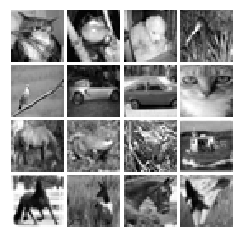

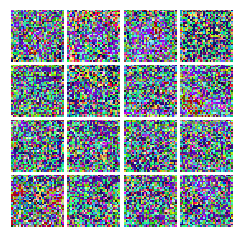

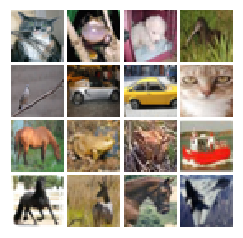

Iter: 0, D: 0.4652, G:12.82
Iter: 50, D: 0.02924, G:0.4943
Iter: 100, D: 0.005823, G:0.4953
Iter: 150, D: 0.008627, G:0.5031
Iter: 200, D: 0.004797, G:0.5


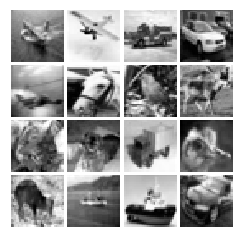

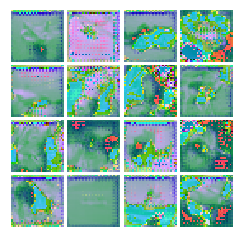

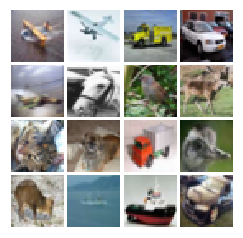

Iter: 250, D: 0.1912, G:0.2119
Iter: 300, D: 0.05643, G:0.3119
Iter: 350, D: 0.2467, G:0.2127
Iter: 400, D: 0.1822, G:0.1591
Iter: 450, D: 0.1676, G:0.4207


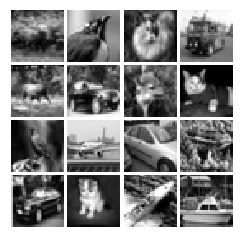

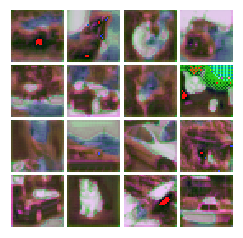

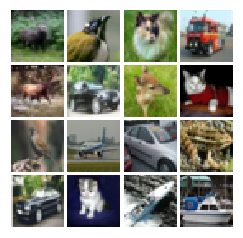

Iter: 500, D: 0.2043, G:0.2109
Iter: 550, D: 0.1756, G:0.3261
Iter: 600, D: 0.1593, G:0.2953
Iter: 650, D: 0.06784, G:0.3531
Iter: 700, D: 0.07999, G:0.3439


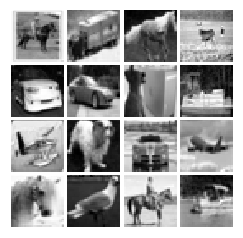

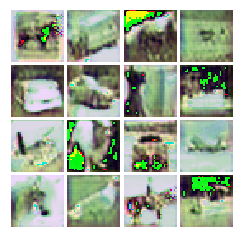

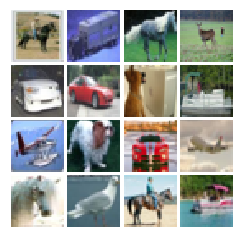

Iter: 750, D: 0.295, G:0.224
Iter: 800, D: 0.09903, G:0.2759
Iter: 850, D: 0.2038, G:0.3608
Iter: 900, D: 0.07305, G:0.37
Iter: 950, D: 0.1286, G:0.3454


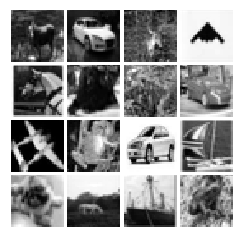

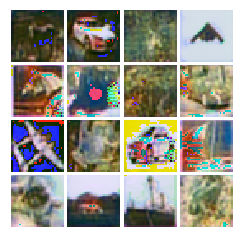

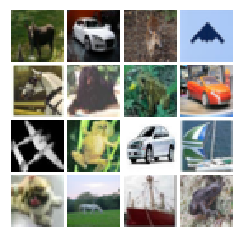

Iter: 1000, D: 0.1691, G:0.4083
Iter: 1050, D: 0.08621, G:0.2832
Iter: 1100, D: 0.1251, G:0.3061
Iter: 1150, D: 0.09209, G:0.3506
Iter: 1200, D: 0.08267, G:0.3911


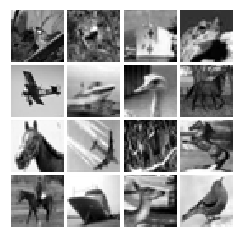

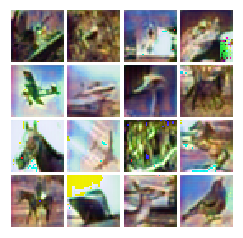

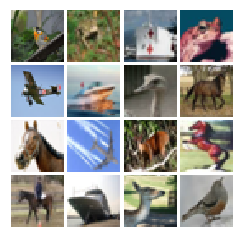

Iter: 1250, D: 0.0715, G:0.4387
Iter: 1300, D: 0.1231, G:0.2827
Iter: 1350, D: 0.02021, G:0.4383
Iter: 1400, D: 0.05468, G:0.4777
Iter: 1450, D: 0.02054, G:0.4281


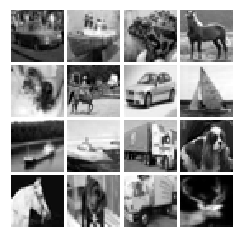

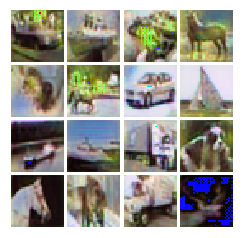

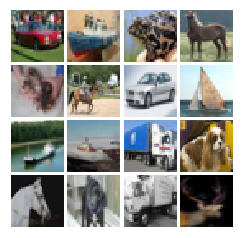

Iter: 1500, D: 0.03453, G:0.4111
Iter: 1550, D: 0.1108, G:0.3643
Iter: 1600, D: 0.2249, G:0.4027
Iter: 1650, D: 0.1339, G:0.2054
Iter: 1700, D: 0.05223, G:0.4167


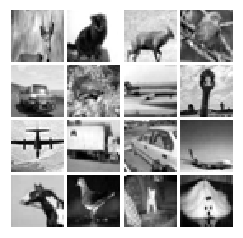

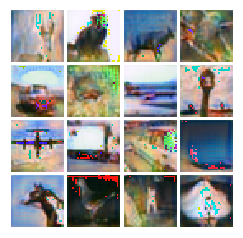

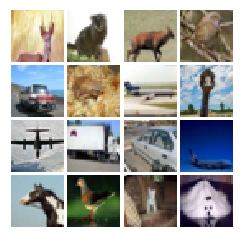

Iter: 1750, D: 0.0355, G:0.4275
Iter: 1800, D: 0.2349, G:0.1452
Iter: 1850, D: 0.2326, G:0.2126
Iter: 1900, D: 0.2118, G:0.2245
Iter: 1950, D: 0.1051, G:0.3007


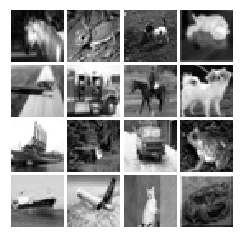

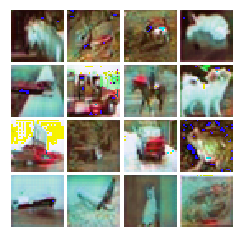

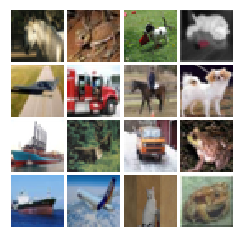

Iter: 2000, D: 0.07018, G:0.4552
Iter: 2050, D: 0.1735, G:0.3993
Iter: 2100, D: 0.06287, G:0.3481
Iter: 2150, D: 0.1094, G:0.3916
Iter: 2200, D: 0.2202, G:0.3029


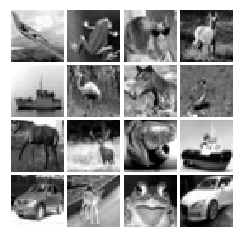

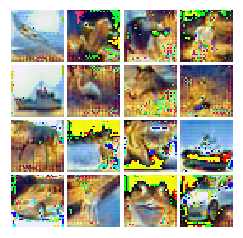

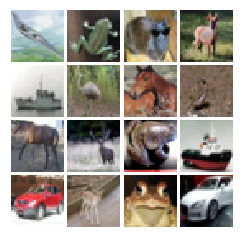

Iter: 2250, D: 0.2231, G:0.2135
Iter: 2300, D: 0.06226, G:0.4335
Iter: 2350, D: 0.04905, G:0.3496
Iter: 2400, D: 0.1802, G:0.3882
Iter: 2450, D: 0.02582, G:0.4183


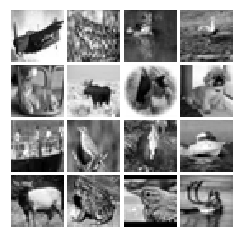

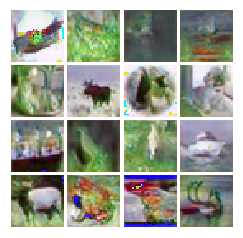

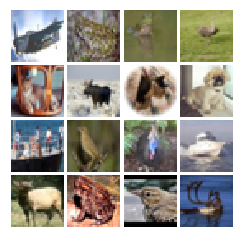

Iter: 2500, D: 0.1305, G:0.321
Iter: 2550, D: 0.06856, G:0.3854
Iter: 2600, D: 0.1837, G:0.4494
Iter: 2650, D: 0.08735, G:0.4367
Iter: 2700, D: 0.1022, G:0.4524


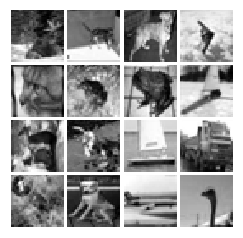

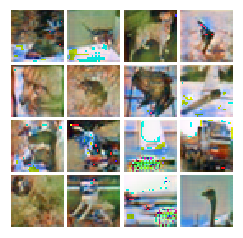

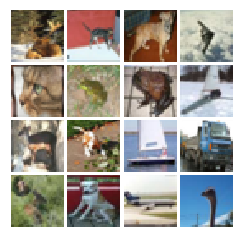

Iter: 2750, D: 0.03917, G:0.4487
Iter: 2800, D: 0.04558, G:0.4259
Iter: 2850, D: 0.09143, G:0.397
Iter: 2900, D: 0.09193, G:0.4277
Iter: 2950, D: 0.1193, G:0.3431


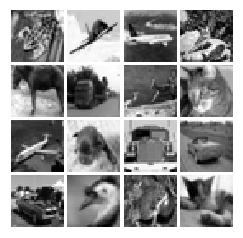

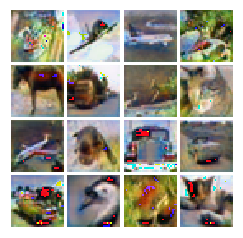

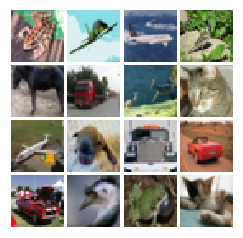

Iter: 3000, D: 0.08556, G:0.3539
Iter: 3050, D: 0.1488, G:0.4321
Iter: 3100, D: 0.0751, G:0.3905
Iter: 3150, D: 0.05235, G:0.414
Iter: 3200, D: 0.07089, G:0.4519


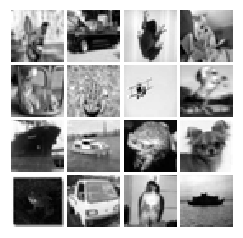

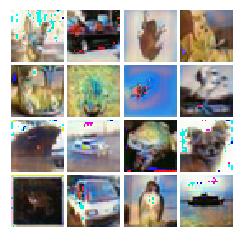

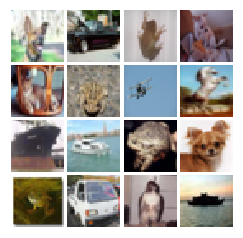

Iter: 3250, D: 0.06301, G:0.3696
Iter: 3300, D: 0.116, G:0.4527
Iter: 3350, D: 0.06904, G:0.4156
Iter: 3400, D: 0.06442, G:0.4309
Iter: 3450, D: 0.08881, G:0.4296


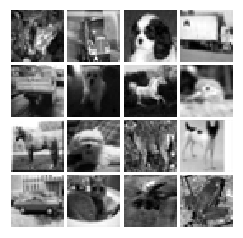

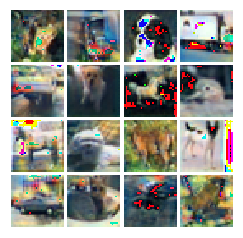

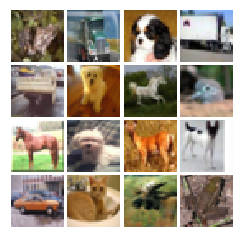

Iter: 3500, D: 0.09989, G:0.3552
Iter: 3550, D: 0.05913, G:0.4268
Iter: 3600, D: 0.1017, G:0.3624
Iter: 3650, D: 0.08681, G:0.4093
Iter: 3700, D: 0.04822, G:0.4128


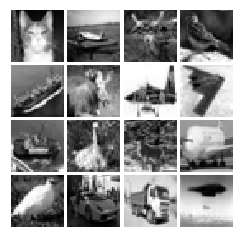

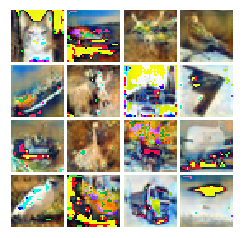

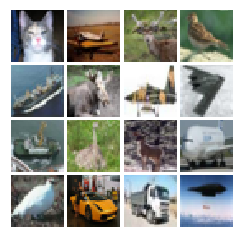

Iter: 3750, D: 0.08307, G:0.4393
Iter: 3800, D: 0.1412, G:0.416
Iter: 3850, D: 0.2684, G:0.3942
Iter: 3900, D: 0.06178, G:0.413
Iter: 3950, D: 0.02805, G:0.4524


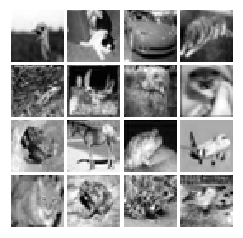

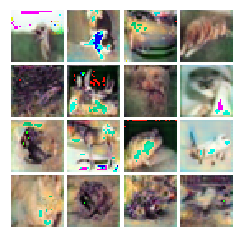

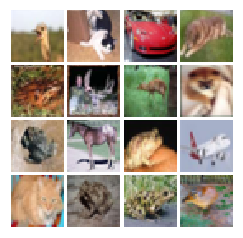

Iter: 4000, D: 0.07106, G:0.4207
Iter: 4050, D: 0.0287, G:0.4269
Iter: 4100, D: 0.07675, G:0.3593
Iter: 4150, D: 0.05258, G:0.4223
Iter: 4200, D: 0.03991, G:0.4678


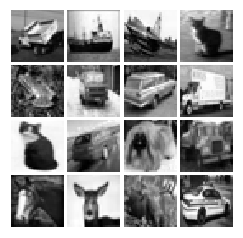

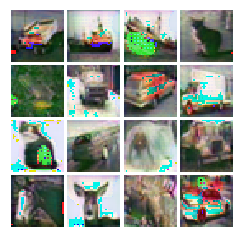

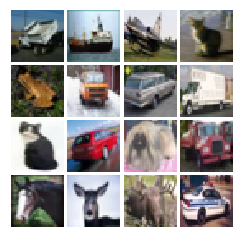

Iter: 4250, D: 0.02365, G:0.4435
Iter: 4300, D: 0.01953, G:0.4785
Iter: 4350, D: 0.1922, G:0.2454
Iter: 4400, D: 0.05394, G:0.4453
Iter: 4450, D: 0.04289, G:0.3713


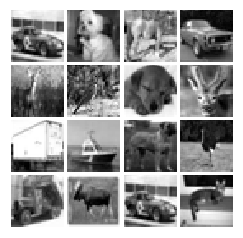

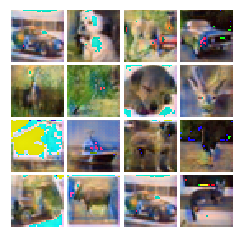

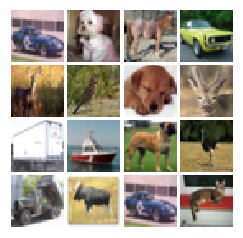

Iter: 4500, D: 0.02264, G:0.4369
Iter: 4550, D: 0.09861, G:0.4521
Iter: 4600, D: 0.1552, G:0.3155
Iter: 4650, D: 0.06248, G:0.4438
Iter: 4700, D: 0.1173, G:0.4085


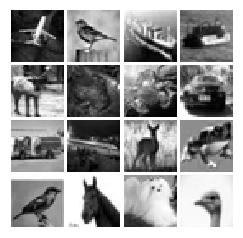

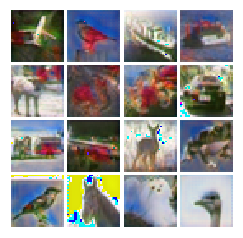

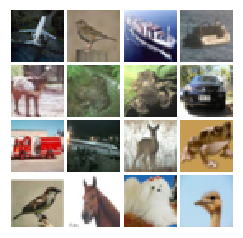

Iter: 4750, D: 0.04924, G:0.4471
Iter: 4800, D: 0.02973, G:0.4524
Iter: 4850, D: 0.09868, G:0.4365
Iter: 4900, D: 0.04508, G:0.4231
Iter: 4950, D: 0.06116, G:0.4817


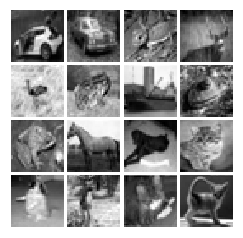

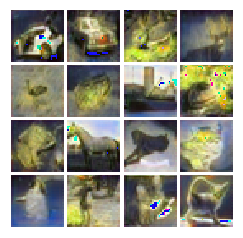

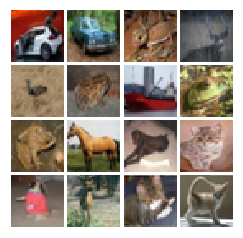

Iter: 5000, D: 0.1296, G:0.2517
Iter: 5050, D: 0.03904, G:0.4342
Iter: 5100, D: 0.06229, G:0.3525
Iter: 5150, D: 0.04725, G:0.3948
Iter: 5200, D: 0.1552, G:0.354


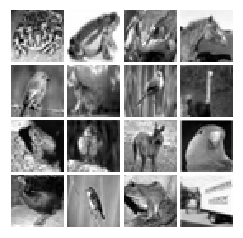

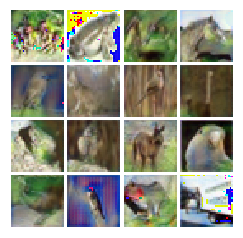

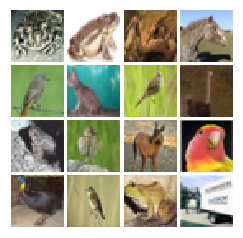

Iter: 5250, D: 0.05201, G:0.4644
Iter: 5300, D: 0.05757, G:0.4199
Iter: 5350, D: 0.02747, G:0.425
Iter: 5400, D: 0.06571, G:0.4046
Iter: 5450, D: 0.07304, G:0.3855


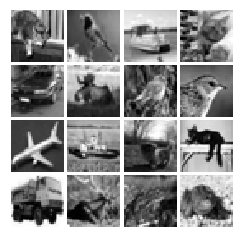

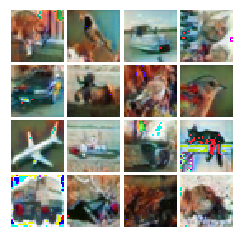

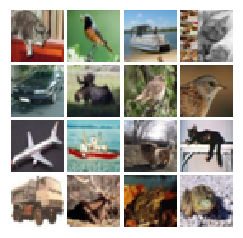

Iter: 5500, D: 0.05866, G:0.4689
Iter: 5550, D: 0.0396, G:0.4398
Iter: 5600, D: 0.00835, G:0.4653
Iter: 5650, D: 0.2079, G:0.2321
Iter: 5700, D: 0.05324, G:0.4044


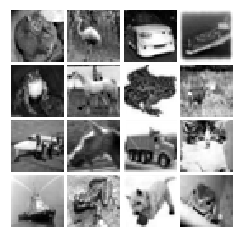

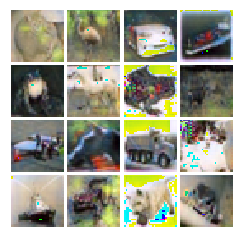

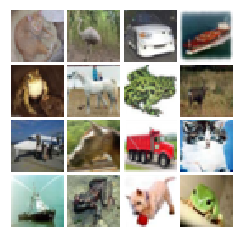

Iter: 5750, D: 0.03328, G:0.4595
Iter: 5800, D: 0.03842, G:0.49
Iter: 5850, D: 0.04214, G:0.4404
Iter: 5900, D: 0.03574, G:0.4617
Iter: 5950, D: 0.06928, G:0.4468


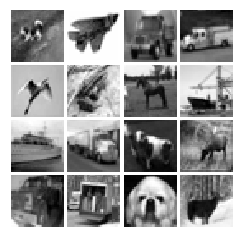

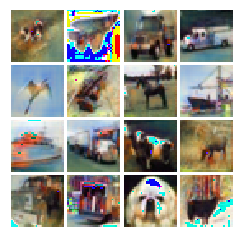

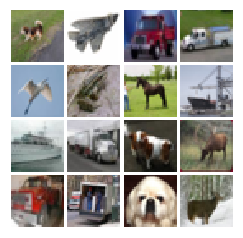

Iter: 6000, D: 0.05291, G:0.426
Iter: 6050, D: 0.04548, G:0.4696
Iter: 6100, D: 0.124, G:0.4567
Iter: 6150, D: 0.03678, G:0.4509
Iter: 6200, D: 0.1372, G:0.4516


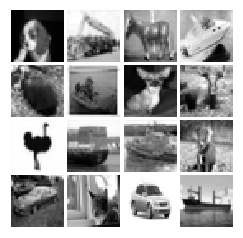

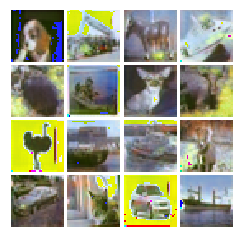

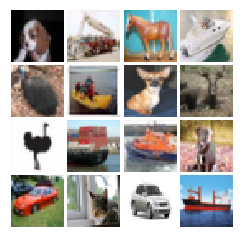

Iter: 6250, D: 0.0931, G:0.437
Iter: 6300, D: 0.03377, G:0.4531
Iter: 6350, D: 0.1114, G:0.4359
Iter: 6400, D: 0.06058, G:0.4385
Iter: 6450, D: 0.0547, G:0.4315


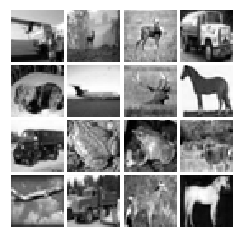

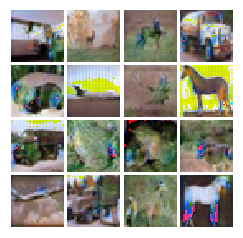

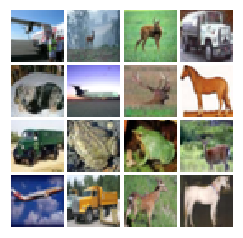

Iter: 6500, D: 0.04693, G:0.4361
Iter: 6550, D: 0.07752, G:0.4105
Iter: 6600, D: 0.04318, G:0.4403
Iter: 6650, D: 0.03255, G:0.4594
Iter: 6700, D: 0.04319, G:0.4304


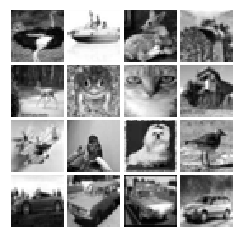

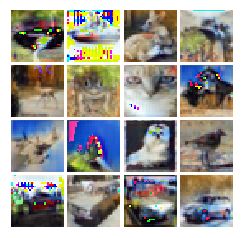

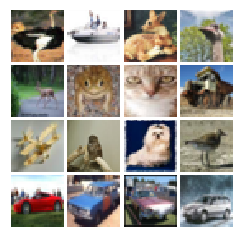

Iter: 6750, D: 0.06772, G:0.3981
Iter: 6800, D: 0.05448, G:0.45
Iter: 6850, D: 0.07981, G:0.4639
Iter: 6900, D: 0.1058, G:0.3925
Iter: 6950, D: 0.04755, G:0.3846


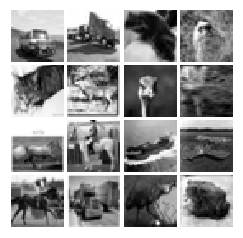

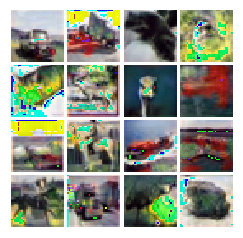

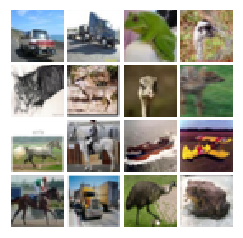

Iter: 7000, D: 0.03275, G:0.4569
Iter: 7050, D: 0.05603, G:0.4583
Iter: 7100, D: 0.0129, G:0.474
Iter: 7150, D: 0.009035, G:0.4708
Iter: 7200, D: 0.01885, G:0.4755


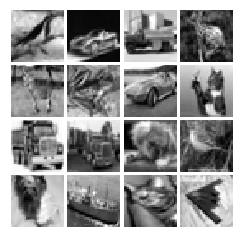

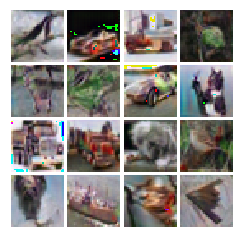

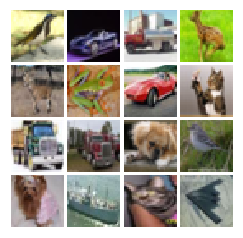

Iter: 7250, D: 0.01034, G:0.4512
Iter: 7300, D: 0.0136, G:0.4897
Iter: 7350, D: 0.01317, G:0.4551
Iter: 7400, D: 0.04432, G:0.4579
Iter: 7450, D: 0.008238, G:0.4692


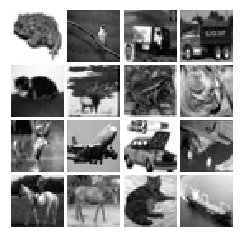

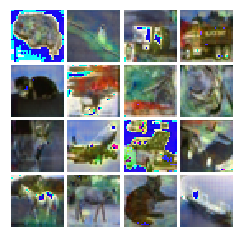

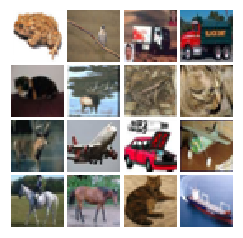

Iter: 7500, D: 0.0301, G:0.4805
Iter: 7550, D: 0.07989, G:0.3239
Iter: 7600, D: 0.02768, G:0.4716
Iter: 7650, D: 0.01833, G:0.4955
Iter: 7700, D: 0.03722, G:0.4359


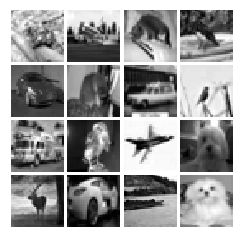

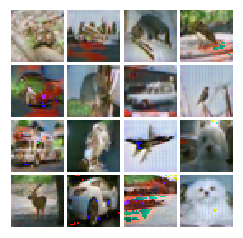

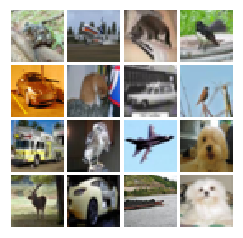

Iter: 7750, D: 0.01543, G:0.4819
Iter: 7800, D: 0.02068, G:0.4908
Iter: 7850, D: 0.03961, G:0.4414
Iter: 7900, D: 0.01885, G:0.4379
Iter: 7950, D: 0.01068, G:0.4543


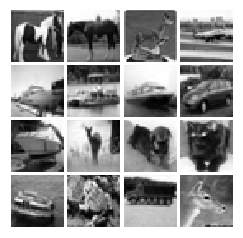

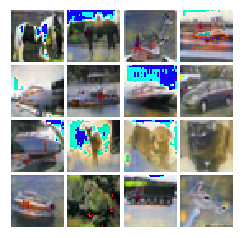

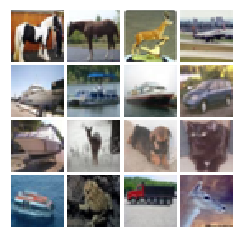

Iter: 8000, D: 0.06345, G:0.3921
Iter: 8050, D: 0.04398, G:0.4794
Iter: 8100, D: 0.04155, G:0.4418
Iter: 8150, D: 0.04685, G:0.3896
Iter: 8200, D: 0.03896, G:0.4116


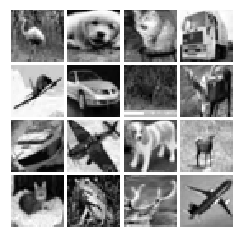

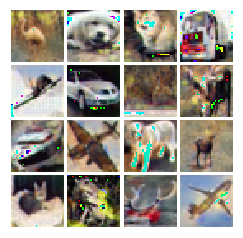

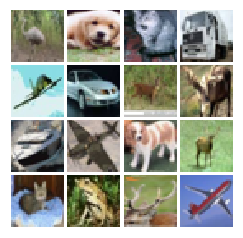

Iter: 8250, D: 0.0646, G:0.4356
Iter: 8300, D: 0.01662, G:0.469
Iter: 8350, D: 0.03479, G:0.4336
Iter: 8400, D: 0.06314, G:0.4796
Iter: 8450, D: 0.02329, G:0.4833


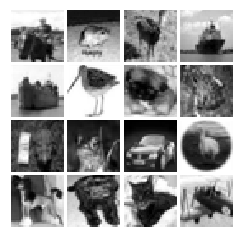

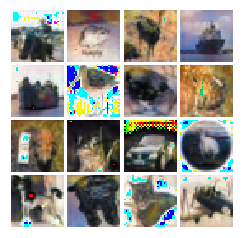

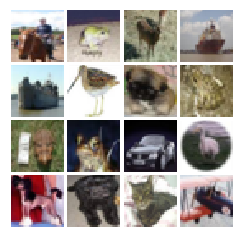

Iter: 8500, D: 0.2121, G:0.2066
Iter: 8550, D: 0.04518, G:0.4493
Iter: 8600, D: 0.0311, G:0.4544
Iter: 8650, D: 0.06044, G:0.464
Iter: 8700, D: 0.0421, G:0.4219


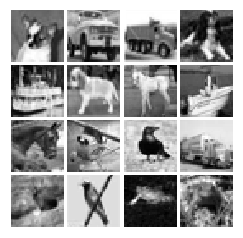

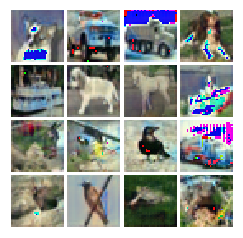

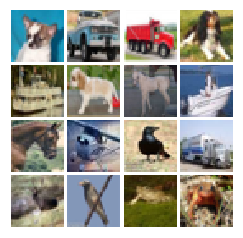

Iter: 8750, D: 0.05355, G:0.4485
Iter: 8800, D: 0.04056, G:0.4617
Iter: 8850, D: 0.02406, G:0.4442
Iter: 8900, D: 0.05159, G:0.4435
Iter: 8950, D: 0.07401, G:0.2831


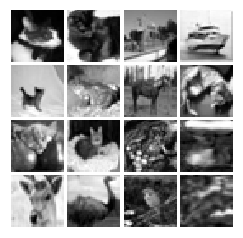

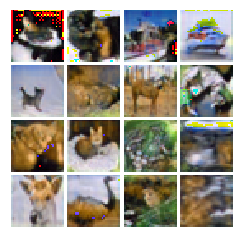

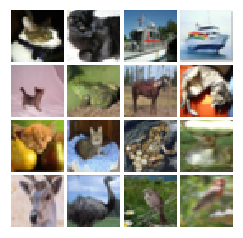

Iter: 9000, D: 0.1121, G:0.4212
Iter: 9050, D: 0.08388, G:0.4627
Iter: 9100, D: 0.03286, G:0.4527
Iter: 9150, D: 0.1699, G:0.4382
Iter: 9200, D: 0.0419, G:0.468


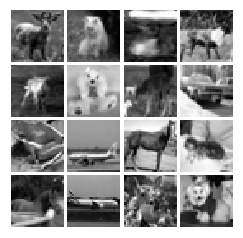

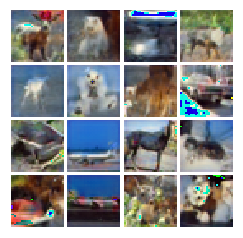

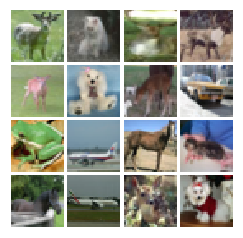

Iter: 9250, D: 0.2216, G:0.2825
Iter: 9300, D: 0.08623, G:0.4469
Iter: 9350, D: 0.06163, G:0.4515
Iter: 9400, D: 0.0617, G:0.5007
Iter: 9450, D: 0.04545, G:0.4311


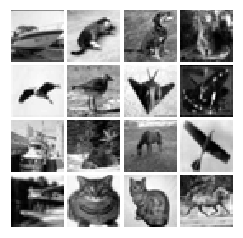

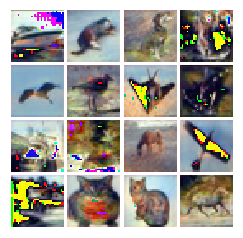

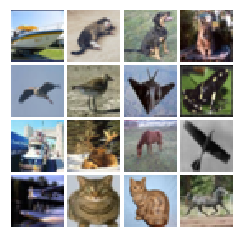

Iter: 9500, D: 0.05584, G:0.4497
Iter: 9550, D: 0.02313, G:0.465
Iter: 9600, D: 0.04005, G:0.3802
Iter: 9650, D: 0.02418, G:0.491
Iter: 9700, D: 0.03902, G:0.3909


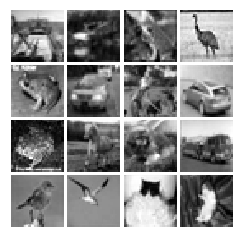

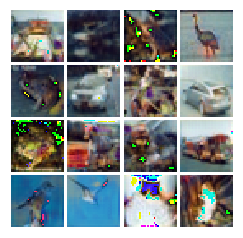

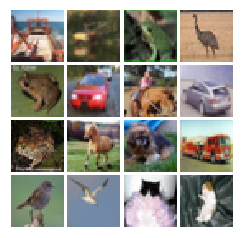

Iter: 9750, D: 0.02129, G:0.4793
Iter: 9800, D: 0.02697, G:0.4578
Iter: 9850, D: 0.02498, G:0.4745
Iter: 9900, D: 0.04713, G:0.4775
Iter: 9950, D: 0.01439, G:0.4922


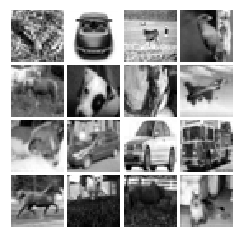

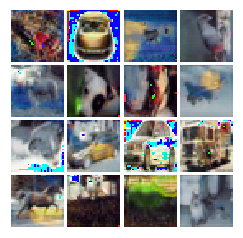

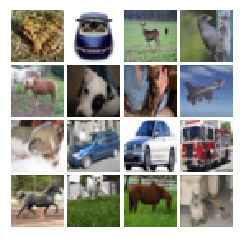

Iter: 10000, D: 0.02691, G:0.4761
Iter: 10050, D: 0.02362, G:0.4454
Iter: 10100, D: 0.03785, G:0.4008
Iter: 10150, D: 0.03334, G:0.4329
Iter: 10200, D: 0.05888, G:0.4264


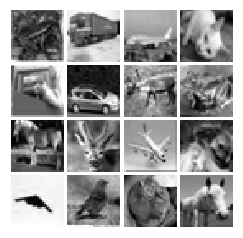

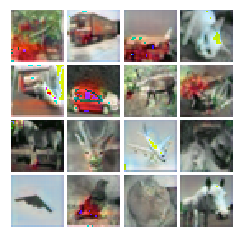

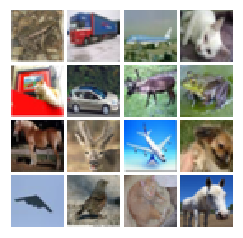

Iter: 10250, D: 0.03283, G:0.4146
Iter: 10300, D: 0.02559, G:0.4511
Iter: 10350, D: 0.03331, G:0.4385
Iter: 10400, D: 0.02373, G:0.4904
Iter: 10450, D: 0.02003, G:0.4491


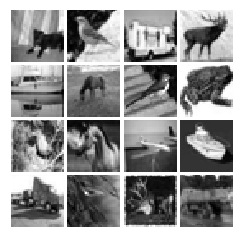

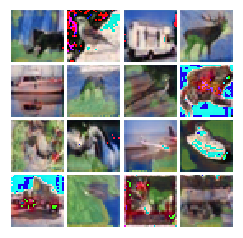

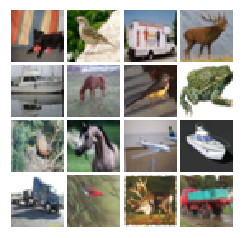

Iter: 10500, D: 0.01497, G:0.4946
Iter: 10550, D: 0.1056, G:0.4866
Iter: 10600, D: 0.01781, G:0.4818
Iter: 10650, D: 0.04234, G:0.3877
Iter: 10700, D: 0.01827, G:0.47


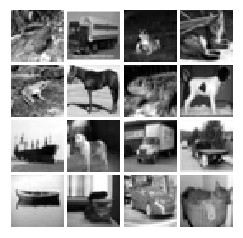

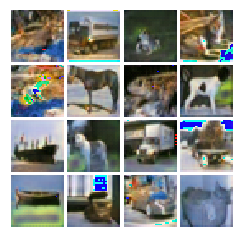

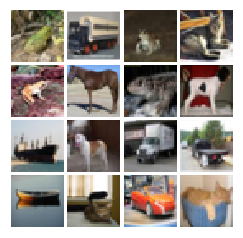

Iter: 10750, D: 0.09466, G:0.3733
Iter: 10800, D: 0.02746, G:0.4812
Iter: 10850, D: 0.04847, G:0.4453
Iter: 10900, D: 0.04131, G:0.4759
Iter: 10950, D: 0.06134, G:0.4539


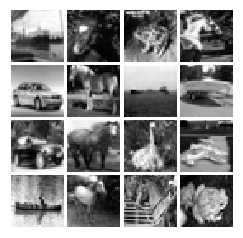

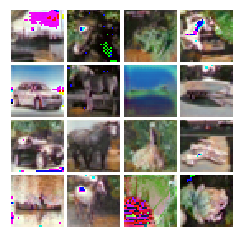

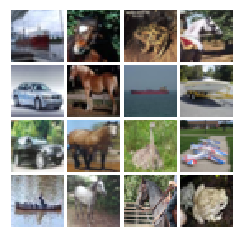

Iter: 11000, D: 0.03487, G:0.4419
Iter: 11050, D: 0.04243, G:0.4892
Iter: 11100, D: 0.03416, G:0.4439
Iter: 11150, D: 0.04101, G:0.4272
Iter: 11200, D: 0.05804, G:0.4311


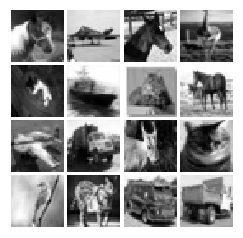

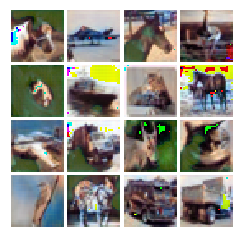

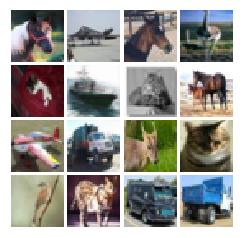

Iter: 11250, D: 0.01486, G:0.4833
Iter: 11300, D: 0.08292, G:0.1523
Iter: 11350, D: 0.07767, G:0.3894
Iter: 11400, D: 0.03689, G:0.462
Iter: 11450, D: 0.04791, G:0.4342


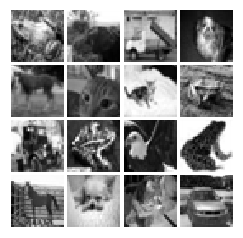

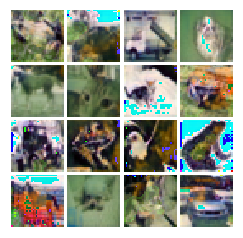

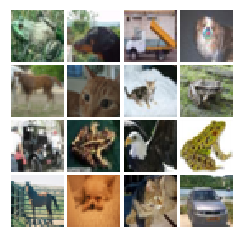

Iter: 11500, D: 0.02747, G:0.4568
Iter: 11550, D: 0.2459, G:0.1269
Iter: 11600, D: 0.2384, G:0.1345
Iter: 11650, D: 0.2387, G:0.1421
Iter: 11700, D: 0.2475, G:0.1943


In [37]:
sess = tf.Session()
#saver = tf.train.Saver()
#saver.restore(sess,'../models/gan_model_cifar_point6')
sess.run(tf.global_variables_initializer())
run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,num_epoch = 30)

In [38]:
saver = tf.train.Saver()
saver.save(sess,'../models/gan_model_cifar_point6')

'../models/gan_model_cifar_point6'

INFO:tensorflow:Restoring parameters from ../models/gan_model_cifar_point6


INFO:tensorflow:Restoring parameters from ../models/gan_model_cifar_point6


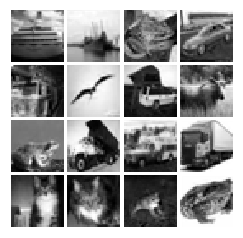

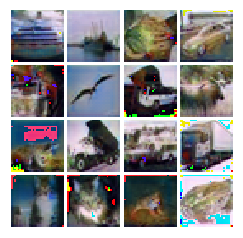

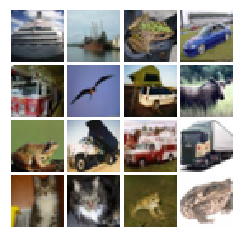

In [13]:
sess = tf.Session()
saver = tf.train.Saver()
saver.restore(sess,'../models/gan_model_cifar_point6')
rand_indices = np.random.choice(np.arange(10000),batch_size)
minibatch = X_test[rand_indices]
samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
fig = show_images2(samples_gray[:16])
plt.show()
samples = sess.run(G_sample,feed_dict = {x:minibatch})
fig = show_images(samples[:16])
plt.show()
fig = show_images(minibatch[:16])
plt.show()

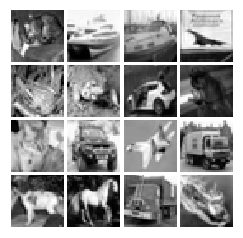

1.0
0.0


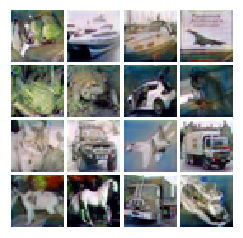

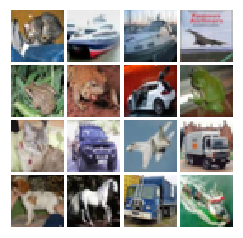

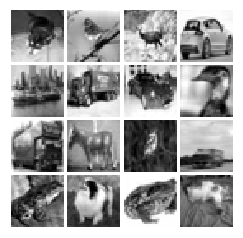

1.0
0.0


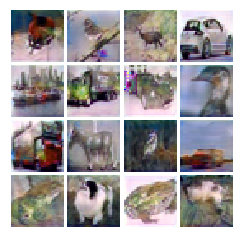

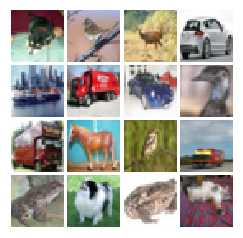

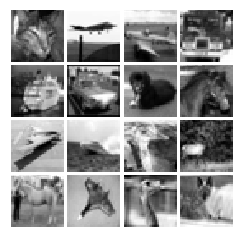

1.0
0.0


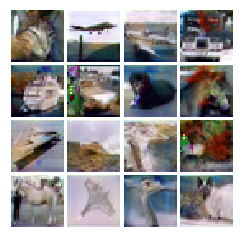

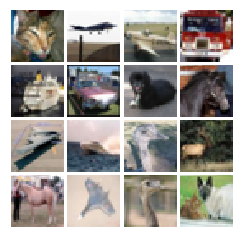

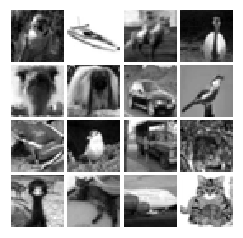

1.0
0.0


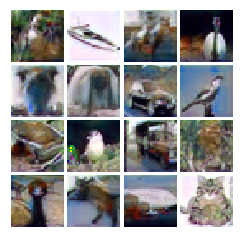

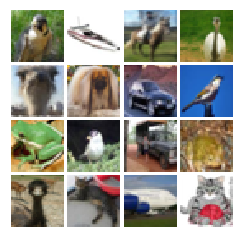

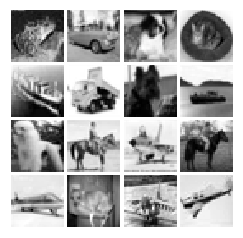

1.0
0.0


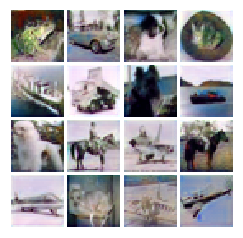

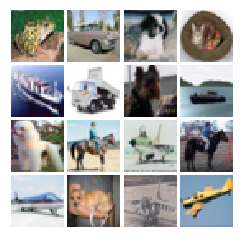

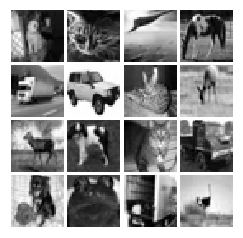

1.0
0.0


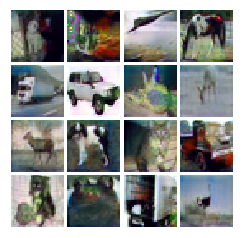

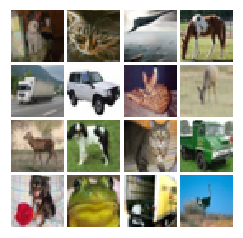

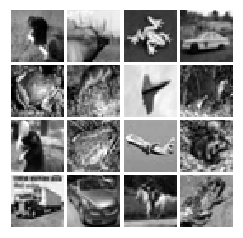

1.0
0.0


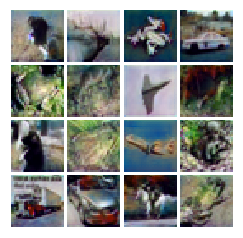

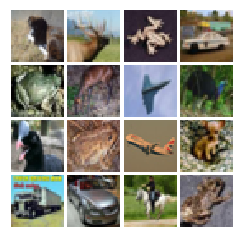

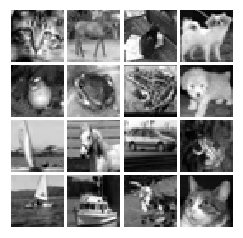

1.0
0.0


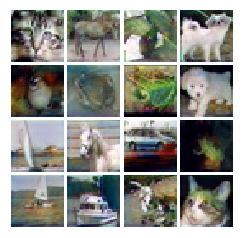

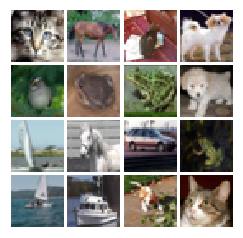

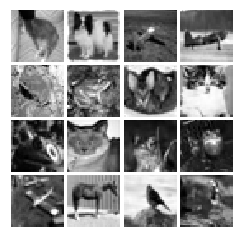

1.0
0.0


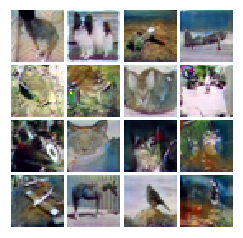

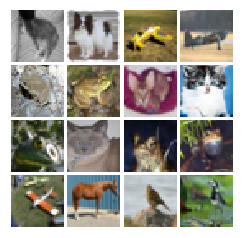

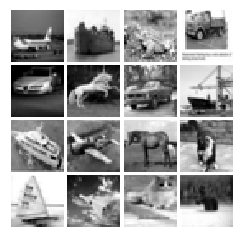

1.0
0.0


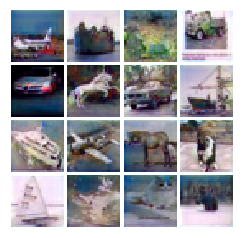

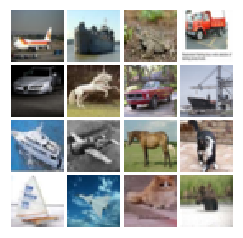

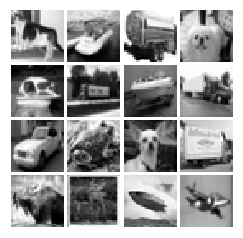

1.0
0.0


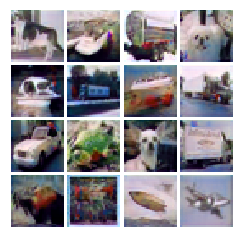

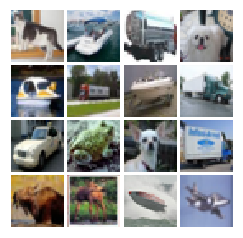

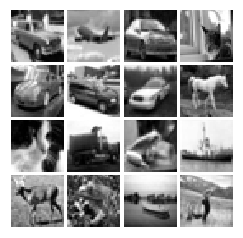

1.0
0.0


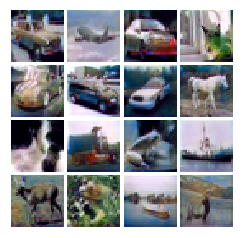

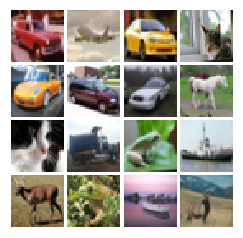

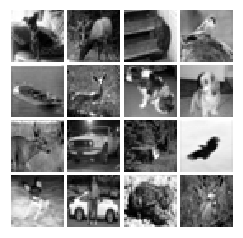

1.0
0.0


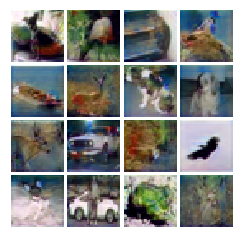

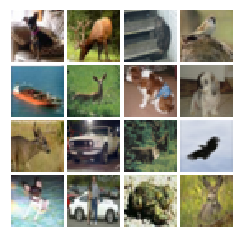

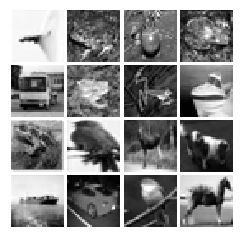

1.0
0.0


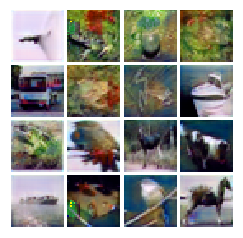

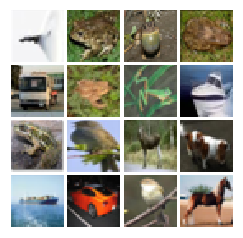

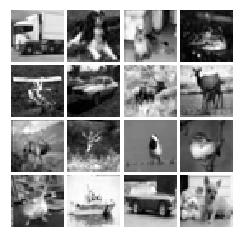

1.0
0.0


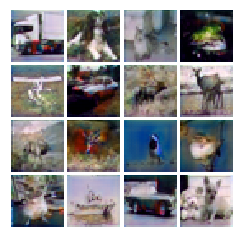

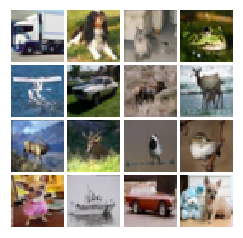

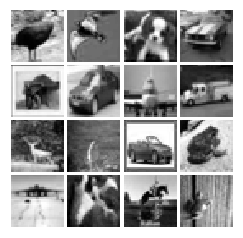

1.0
0.0


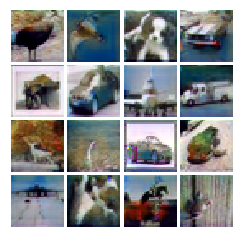

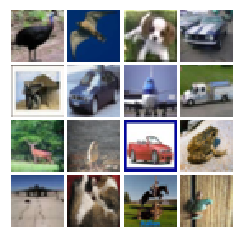

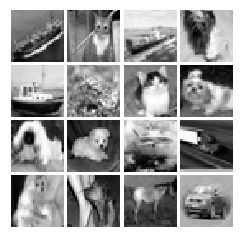

1.0
0.0


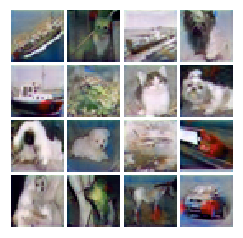

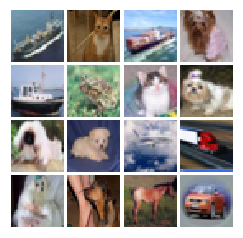

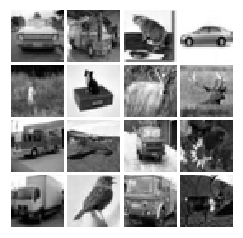

1.0
0.0


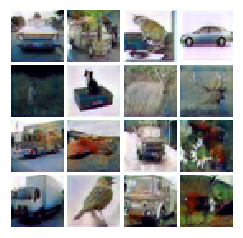

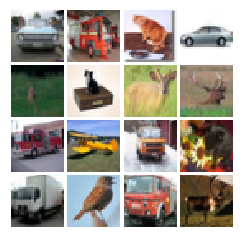

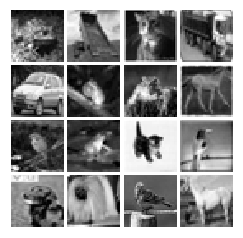

1.0
0.0


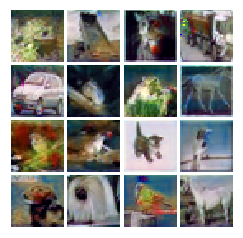

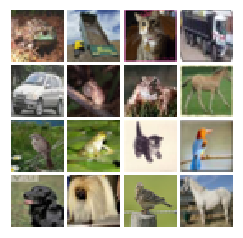

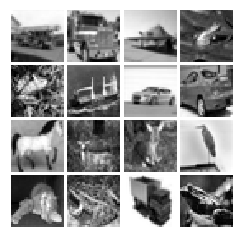

1.0
0.0


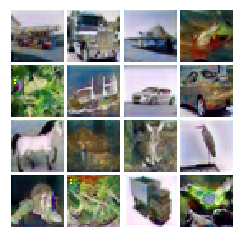

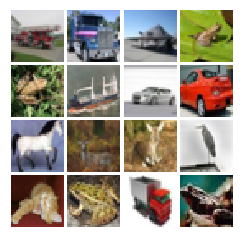

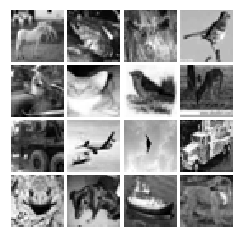

1.0
0.0


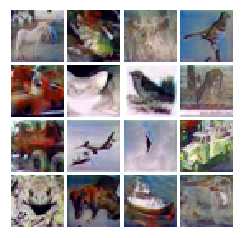

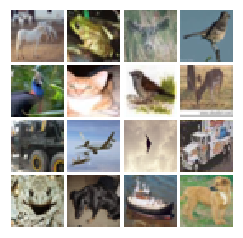

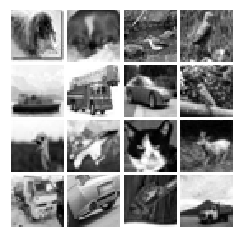

1.0
0.0


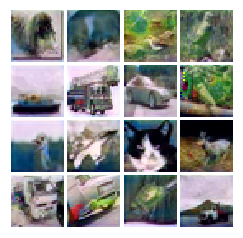

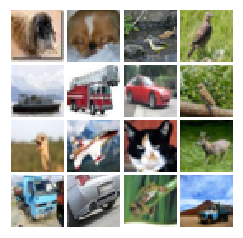

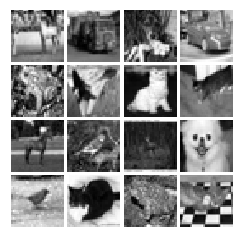

1.0
0.0


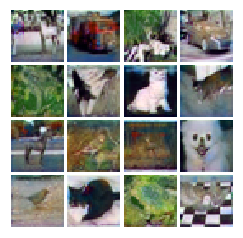

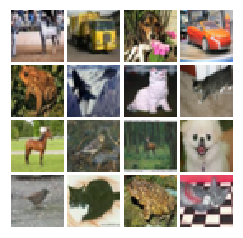

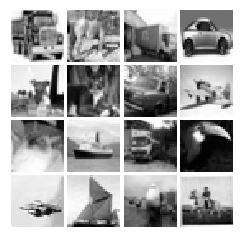

1.0
0.0


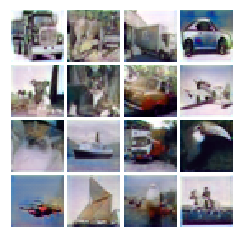

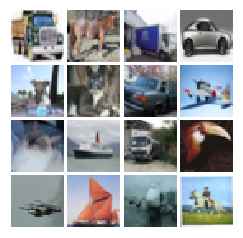

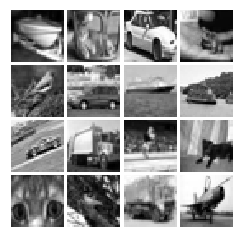

1.0
0.0


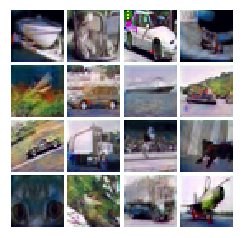

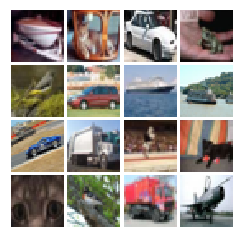

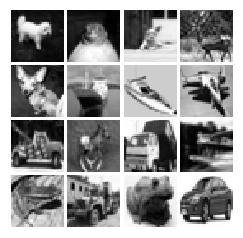

1.0
0.0


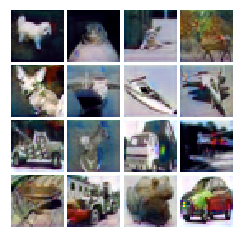

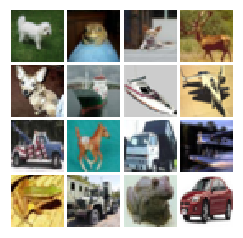

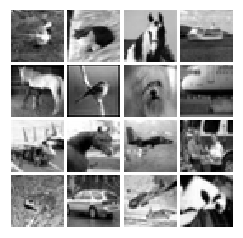

1.0
0.0


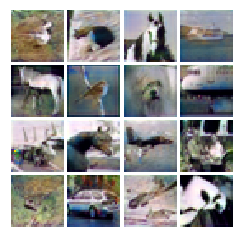

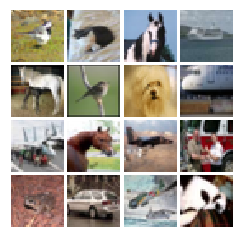

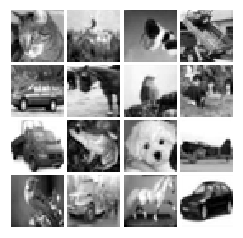

1.0
0.0


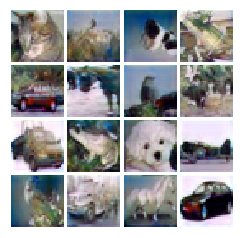

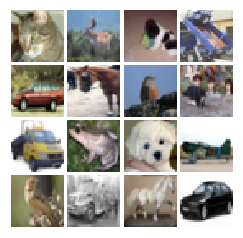

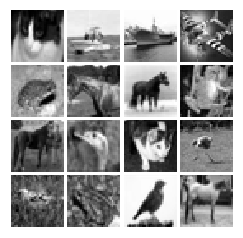

1.0
0.0


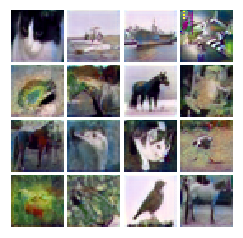

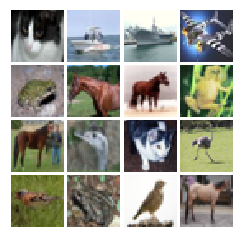

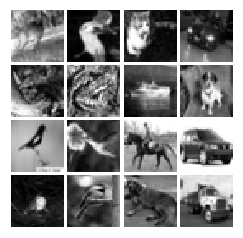

1.0
0.0


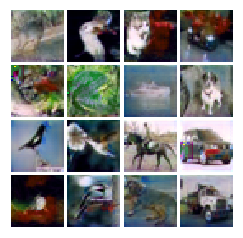

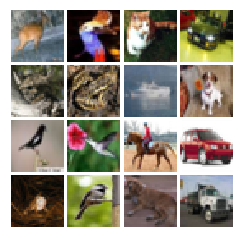

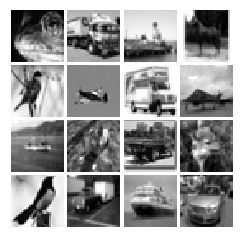

1.0
0.0


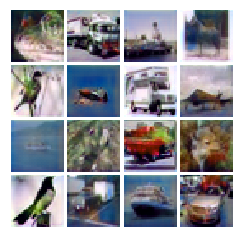

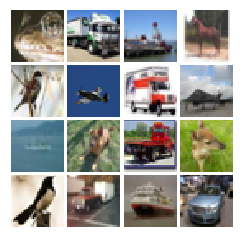

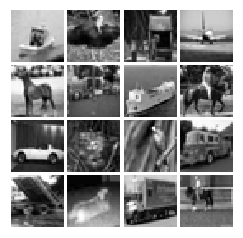

1.0
0.0


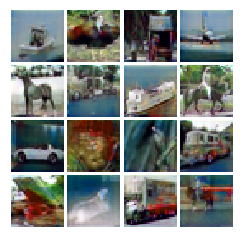

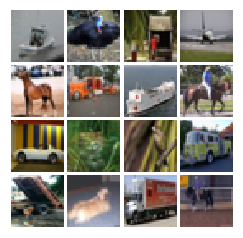

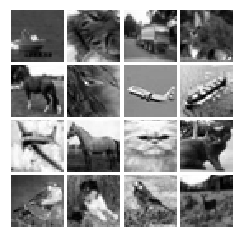

1.0
0.0


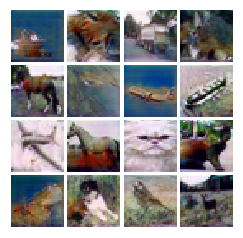

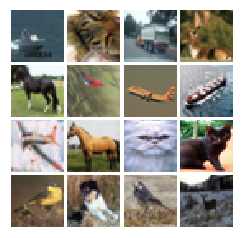

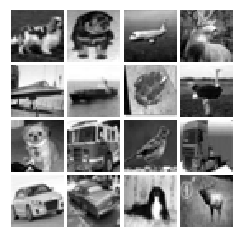

1.0
0.0


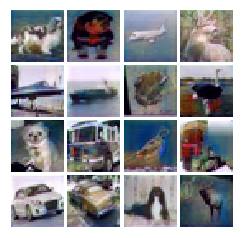

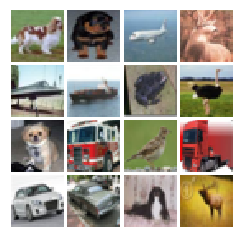

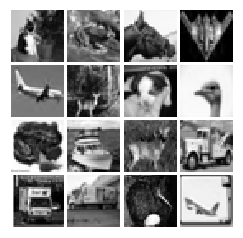

1.0
0.0


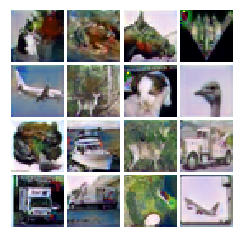

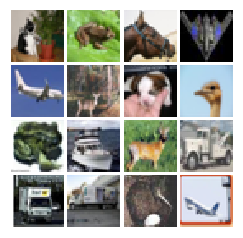

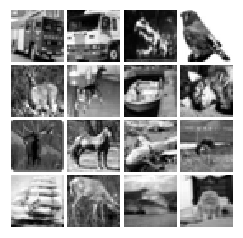

1.0
0.0


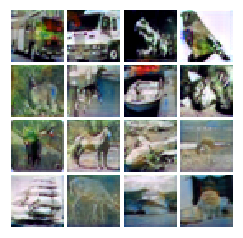

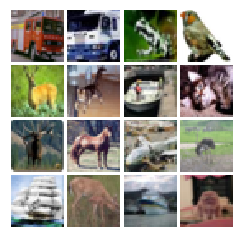

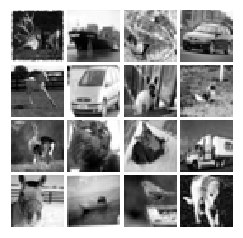

1.0
0.0


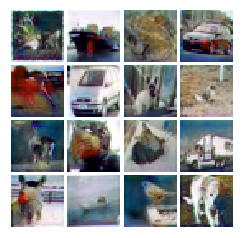

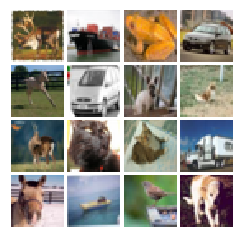

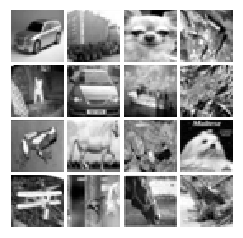

1.0
0.0


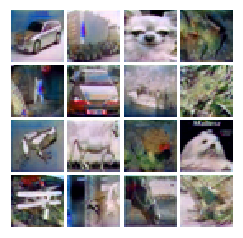

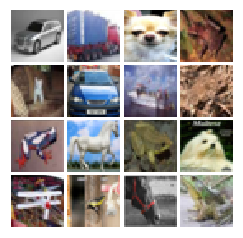

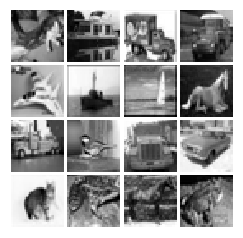

1.0
0.0


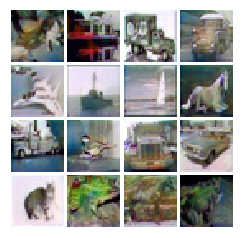

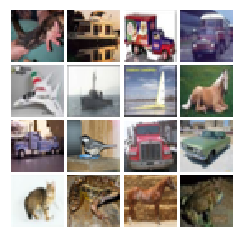

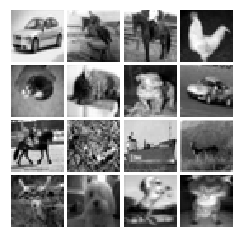

1.0
0.0


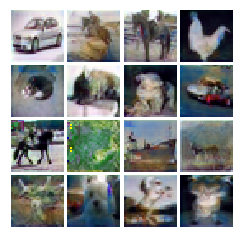

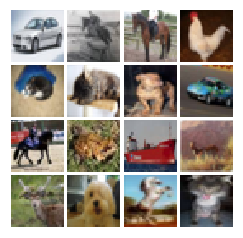

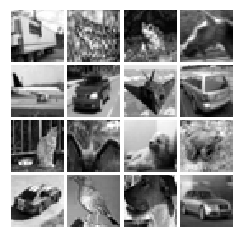

1.0
0.0


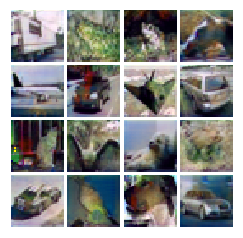

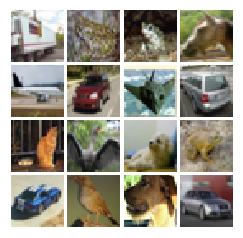

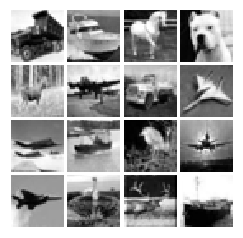

1.0
0.0


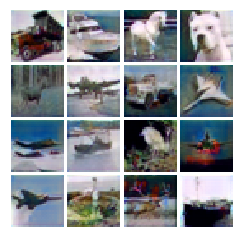

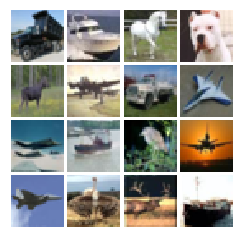

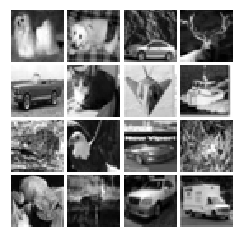

1.0
0.0


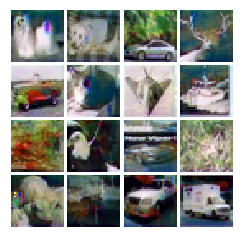

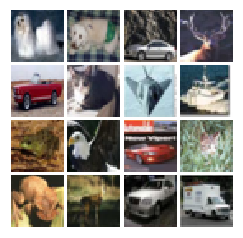

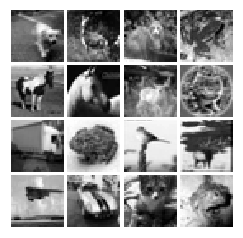

1.0
0.0


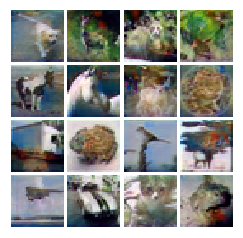

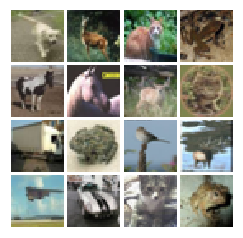

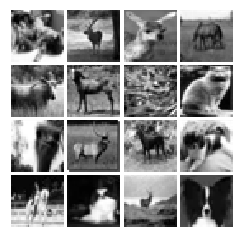

1.0
0.0


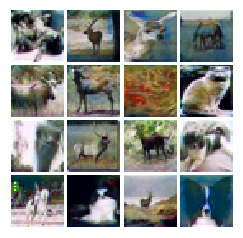

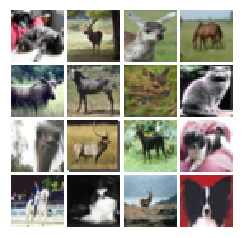

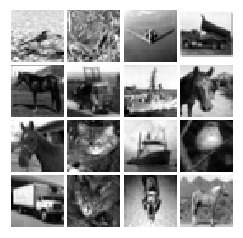

1.0
0.0


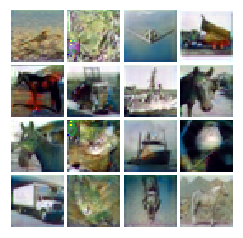

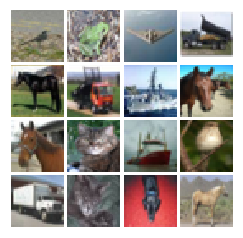

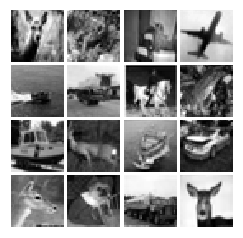

1.0
0.0


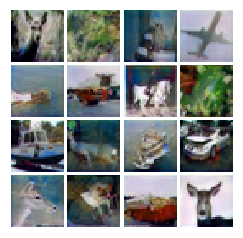

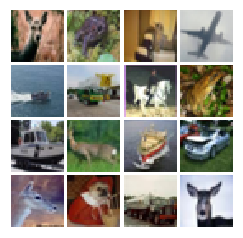

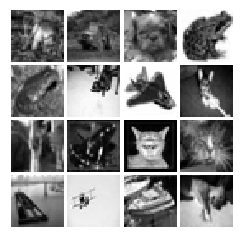

1.0
0.0


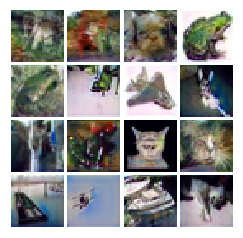

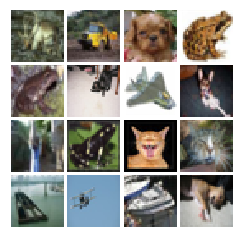

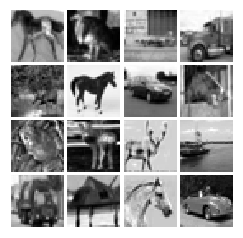

1.0
0.0


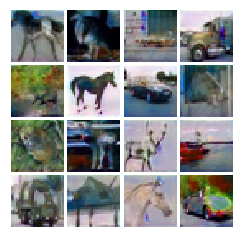

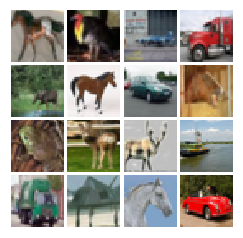

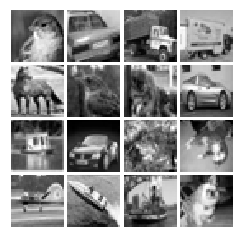

1.0
0.0


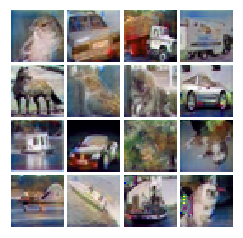

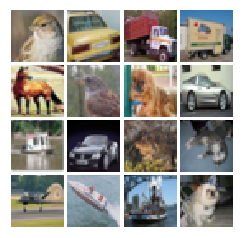

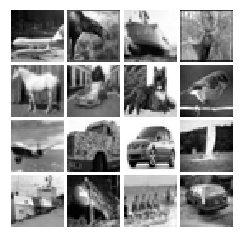

1.0
0.0


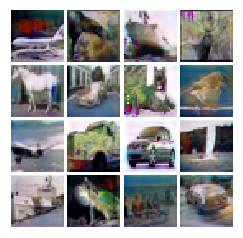

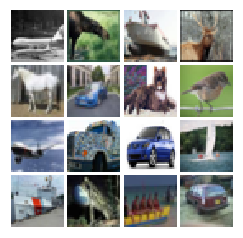

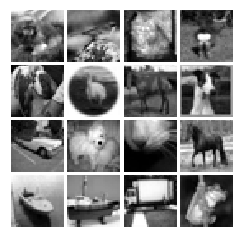

1.0
0.0


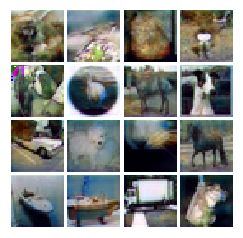

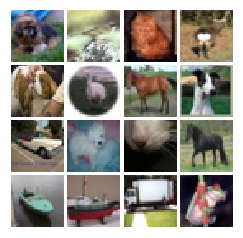

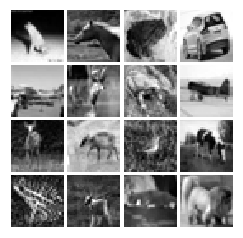

1.0
0.0


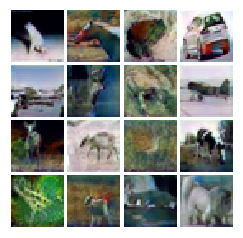

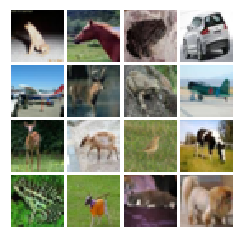

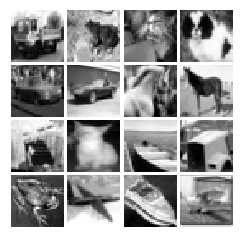

1.0
0.0


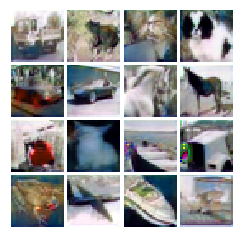

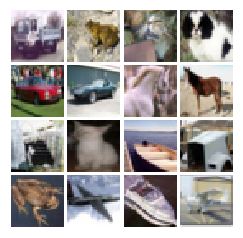

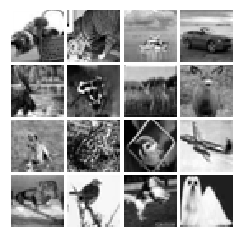

1.0
0.0


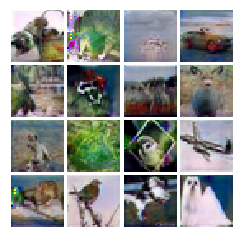

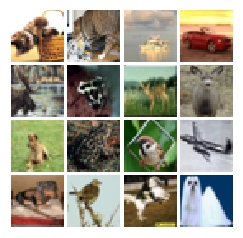

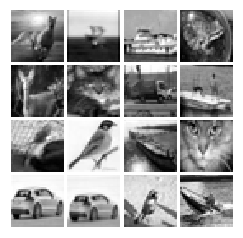

1.0
0.0


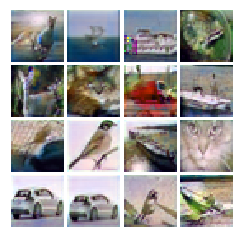

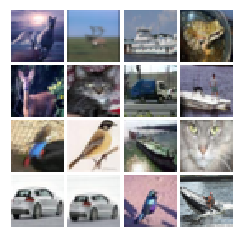

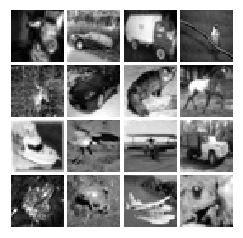

1.0
0.0


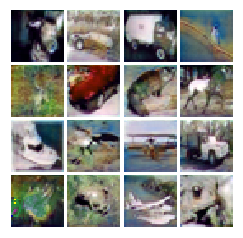

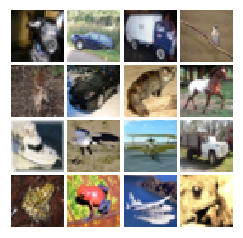

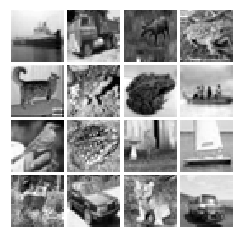

1.0
0.0


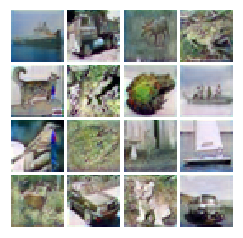

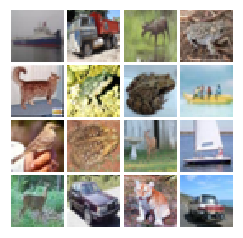

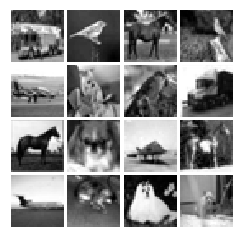

1.0
0.0


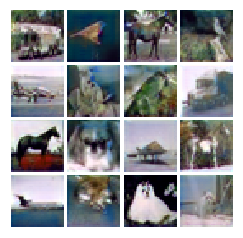

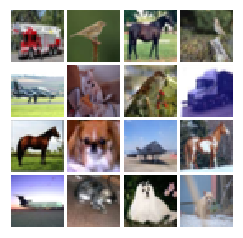

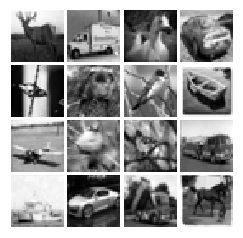

1.0
0.0


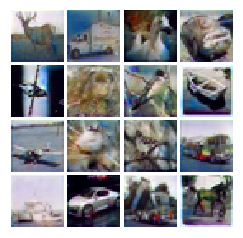

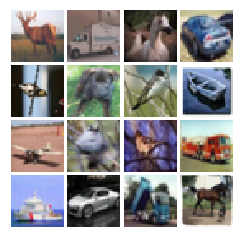

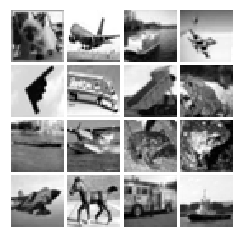

1.0
0.0


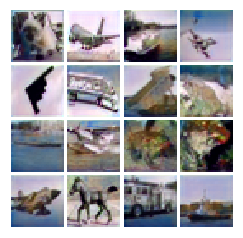

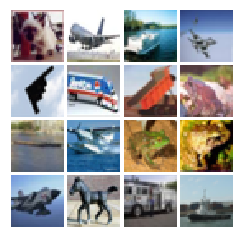

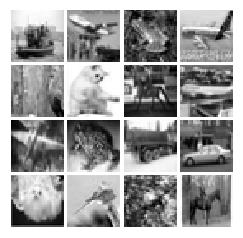

1.0
0.0


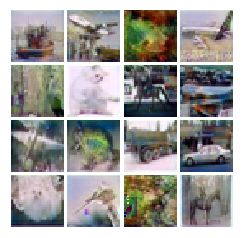

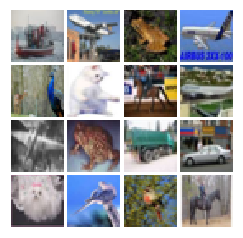

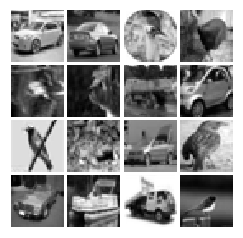

1.0
0.0


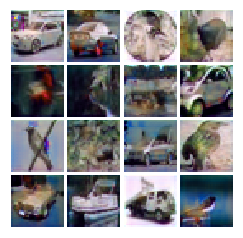

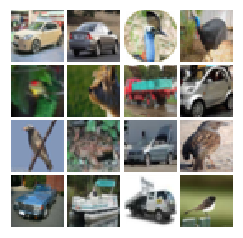

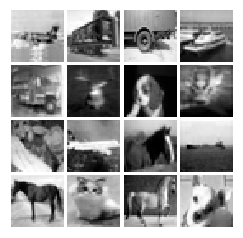

1.0
0.0


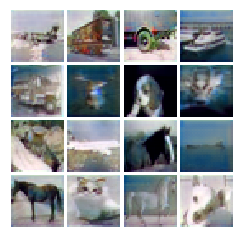

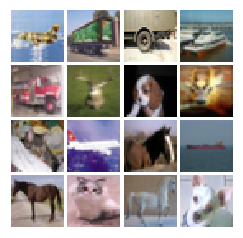

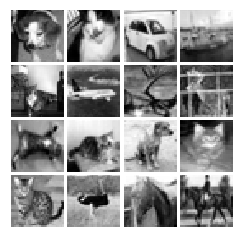

1.0
0.0


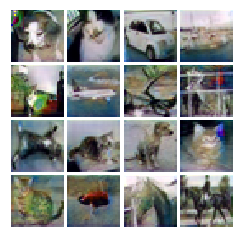

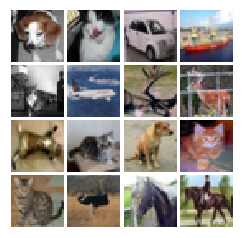

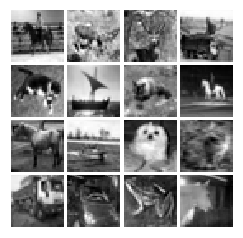

1.0
0.0


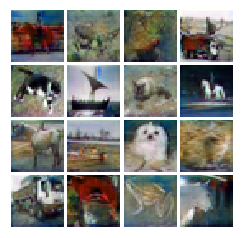

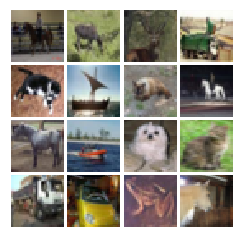

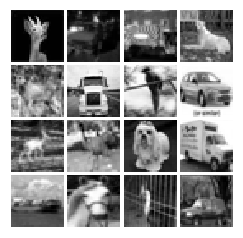

1.0
0.0


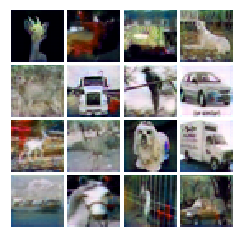

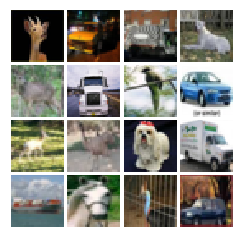

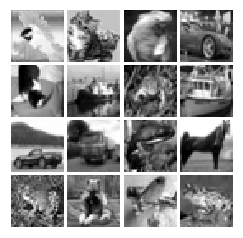

1.0
0.0


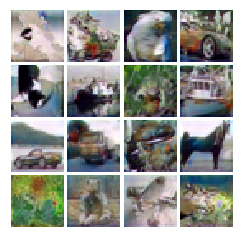

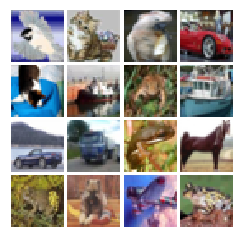

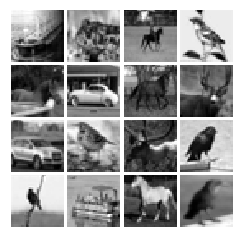

1.0
0.0


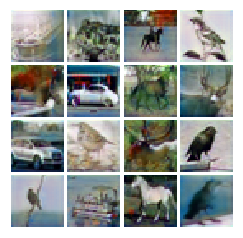

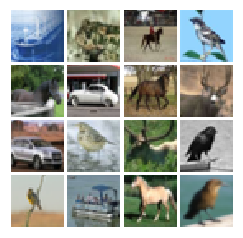

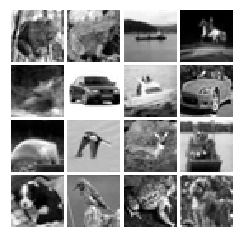

1.0
0.0


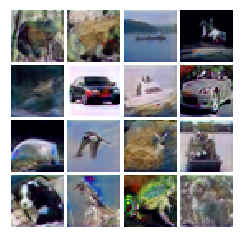

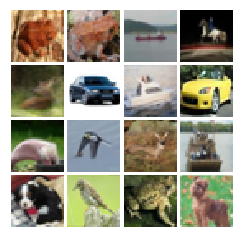

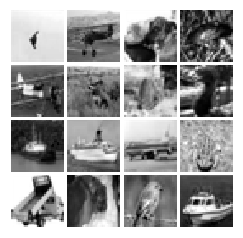

1.0
0.0


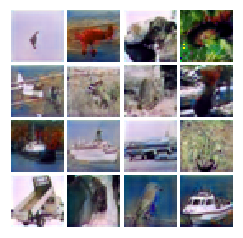

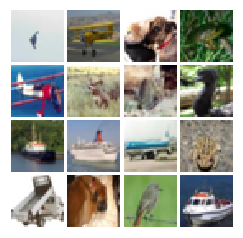

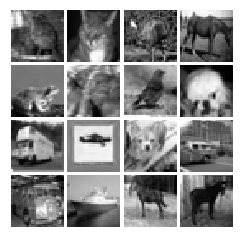

1.0
0.0


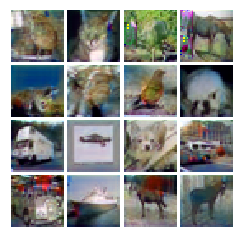

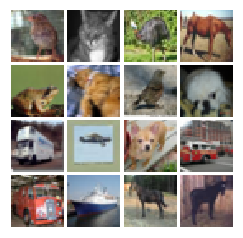

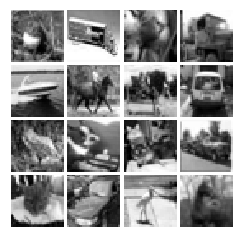

1.0
0.0


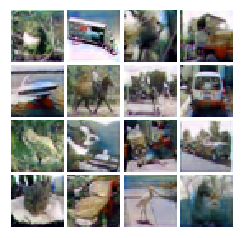

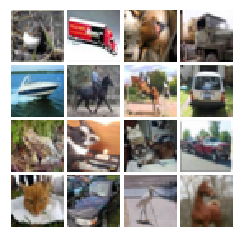

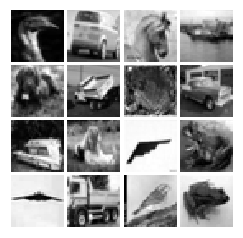

1.0
0.0


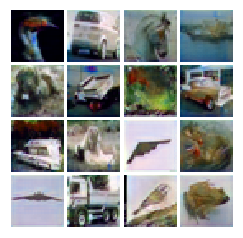

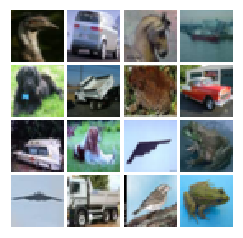

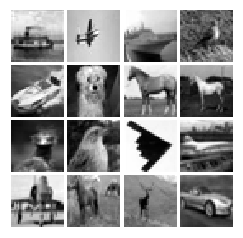

1.0
0.0


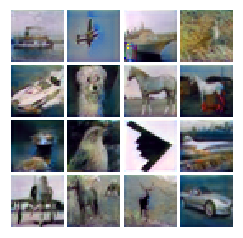

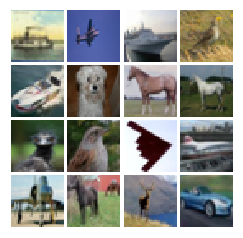

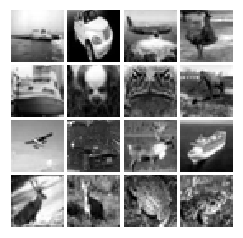

1.0
0.0


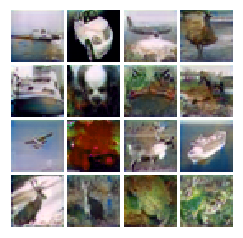

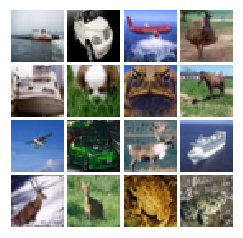

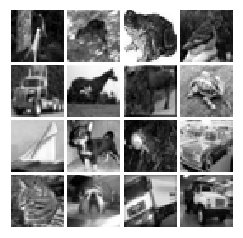

1.0
0.0


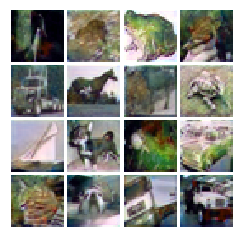

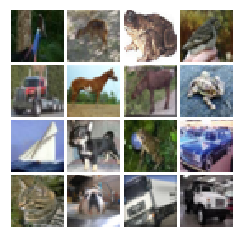

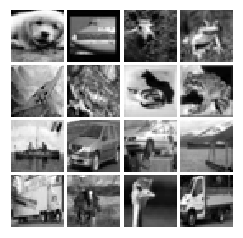

1.0
0.0


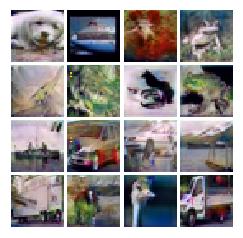

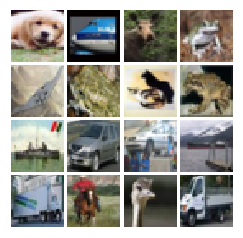

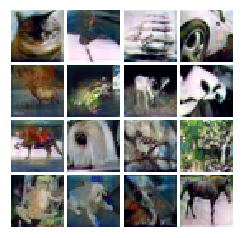

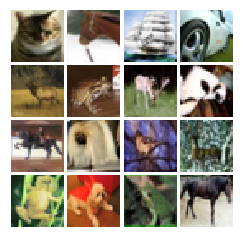

30670848
3072
0.974645270242


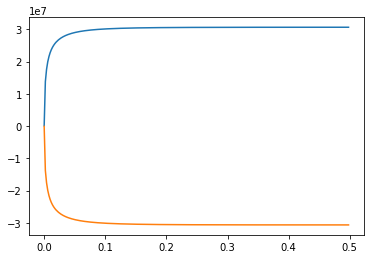

In [14]:
from Loss_metrics import AUC
X_test_sampled = X_test[:128*78,:,:,:]

X_test_model_gen = np.zeros([128*78,X_test.shape[1],X_test.shape[2],X_test.shape[3]])

for i in range(78):
    minibatch = X_test_sampled[i*128:(i+1)*128,:,:,:]
    samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
    fig = show_images2(samples_gray[:16])
    plt.show()
    samples = sess.run(G_sample,feed_dict = {x:minibatch})
    samples[samples>1] = 1
    samples[samples<0]  =0 
    print (np.amax(samples))
    print (np.amin(samples))
    fig = show_images(samples[:16])
    plt.show()
    fig = show_images(minibatch[:16])
    plt.show()
    X_test_model_gen[i*128:(i+1)*128,:,:,:] = samples[:,:,:,:]
 


rgb_i = X_test_sampled
rgb_o = X_test_model_gen
rand_indices = np.random.choice(np.arange(128*78),batch_size)
minibatch = rgb_o[rand_indices]
fig = show_images(minibatch[:16])
plt.show()
minibatch = rgb_i[rand_indices]
fig = show_images(minibatch[:16])
plt.show()
print(rgb_i.size)
print(rgb_o[0].size)
auc, ans = AUC(np.reshape(rgb_i, [128*78, 32, 32, 3]), np.reshape(rgb_o, [128*78, 32, 32, 3]))
print(ans)

plt.plot(np.arange(0., 0.5, 0.5/256), auc)
plt.plot(np.arange(0., 0.5, 0.5/256), 1-auc)

INFO:tensorflow:Restoring parameters from ../models/gan_model_cifar_drop_l2_new_try


INFO:tensorflow:Restoring parameters from ../models/gan_model_cifar_drop_l2_new_try


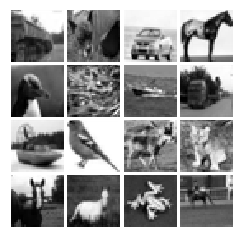

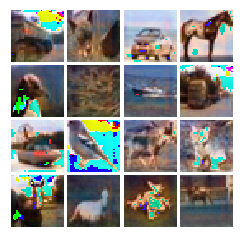

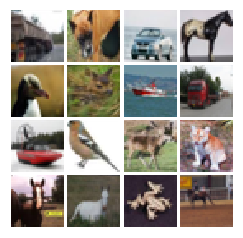

In [17]:
sess = tf.Session()
saver = tf.train.Saver()
saver.restore(sess,'../models/gan_model_cifar_drop_l2_new_try')
rand_indices = np.random.choice(np.arange(10000),batch_size)
minibatch = X_test[rand_indices]
samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
fig = show_images2(samples_gray[:16])
plt.show()
samples = sess.run(G_sample,feed_dict = {x:minibatch})
fig = show_images(samples[:16])
plt.show()
fig = show_images(minibatch[:16])
plt.show()


In [12]:
def generator(X):
    
    with tf.variable_scope("generator"):
        Float_image = X
        
        conv_mat = tf.constant(np.array([[0.299,0.587,0.114],[-0.14713,-0.2888,0.436],[0.615,-0.514999,-0.10001]]),dtype = tf.float32)
        inv_conv_mat = tf.constant(np.array([[1,0,1.13983],[1,-0.39465,-0.58060],[1,2.03211,0]]),dtype = tf.float32)

        Float_image = tf.reshape(Float_image,[-1,3])

        YUV_image = tf.matmul(Float_image,conv_mat)
        YUV_image = tf.reshape(YUV_image,[-1,32,32,3])
        Float_image = tf.reshape(Float_image,[-1,32,32,3])
        UV_p = YUV_image[:,:,:,1:3]
        Y_p = YUV_image[:,:,:,0:1]
        noise = tf.random_uniform(shape = tf.shape(Y_p),minval = -0.2, maxval = 0.2)
        Y_p = Y_p + noise

        a1 = tf.layers.conv2d(Y_p,filters = 16,kernel_size = [5,5],activation = tf.nn.relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = tf.nn.relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = tf.nn.relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 64,kernel_size = [3,3],activation = tf.nn.relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 32,kernel_size = [3,3],activation = tf.nn.relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 16,kernel_size = [1,1],activation = tf.nn.relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 8,kernel_size = [1,1],activation = tf.nn.relu,padding = 'same')
        a1 = tf.layers.batch_normalization(a1,training = True)
        a1 = tf.layers.conv2d(a1,filters = 2,kernel_size = [1,1],activation = tf.tanh,padding = 'same')



        a3 = tf.concat((Y_p,a1),axis = 3)
        #a2 = tf.image.hsv_to_rgb(a3)
        a3 = tf.reshape(a3,[-1,3])
        a2 = tf.matmul(a3,inv_conv_mat)
        RGB_out = tf.reshape(a2,[-1,32,32,3])

    
    return RGB_out,Y_p

In [13]:
tf.reset_default_graph()

batch_size = 64
# our noise dimension
noise_dim = 96

# placeholders for images from the training dataset
x = tf.placeholder(tf.float32, [None, 32,32,3])
#z = sample_noise(batch_size, noise_dim)
# generated images
G_sample,G_in = generator(x)

with tf.variable_scope("") as scope:
    #scale images to be -1 to 1
    logits_real = discriminator(x)
    # Re-use discriminator weights on new inputs
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)

# Get the list of variables for the discriminator and generator
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator') 

D_solver,G_solver = get_solvers()
D_loss, G_loss = lsgan_loss(logits_real, logits_fake)
D_train_step = D_solver.minimize(D_loss, var_list=D_vars)
G_train_step = G_solver.minimize(G_loss, var_list=G_vars)
D_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
G_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')

In [18]:
def run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,\
              show_every=250, print_every=50, batch_size=128, num_epoch=10):
    """Train a GAN for a certain number of epochs.
    
    Inputs:
    - sess: A tf.Session that we want to use to run our data
    - G_train_step: A training step for the Generator
    - G_loss: Generator loss
    - D_train_step: A training step for the Generator
    - D_loss: Discriminator loss
    - G_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for generator
    - D_extra_step: A collection of tf.GraphKeys.UPDATE_OPS for discriminator
    Returns:
        Nothing
    """
    # compute the number of iterations we need
    max_iter = int(50000*num_epoch/batch_size)
    for it in range(max_iter):
        # every show often, show a sample result
        if it % show_every == 0:
            rand_indices = np.random.choice(np.arange(49000),batch_size)
            minibatch = X_train[rand_indices]
            samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
            fig = show_images2(samples_gray[:16])
            plt.show()
            samples = sess.run(G_sample,feed_dict = {x:minibatch})
            fig = show_images(samples[:16])
            plt.show()
            fig = show_images(minibatch[:16])
            plt.show()
            
            print()
        # run a batch of data through the network
        #minibatch,minbatch_y = mnist.train.next_batch(batch_size)
        for ll in range(1):
            rand_indices = np.random.choice(np.arange(49000),batch_size)
            minibatch = X_train[rand_indices]
        #print(minibatch.dtype)
        #print (minibatch.shape)
            _, D_loss_curr = sess.run([D_train_step, D_loss], feed_dict={x: minibatch})
            
        _, G_loss_curr = sess.run([G_train_step, G_loss], feed_dict = {x:minibatch})

        # print loss every so often.
        # We want to make sure D_loss doesn't go to 0
        if it % print_every == 0:
            print('Iter: {}, D: {:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
    #print('Final images')
    #samples = sess.run(G_sample)

    #fig = show_images(samples[:16])
    #plt.show()

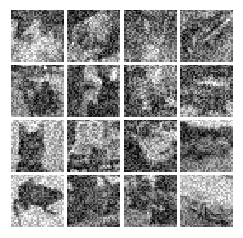

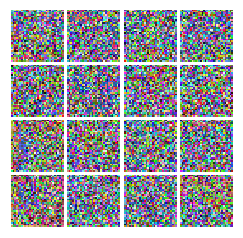

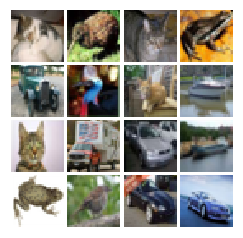


Iter: 0, D: 0.4855, G:0.4221

In [ ]:
sess = tf.Session()
sess.run(tf.global_variables_initializer())
run_a_gan(sess, G_train_step, G_loss, D_train_step, D_loss, G_extra_step, D_extra_step,num_epoch = 20)

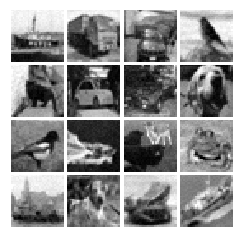

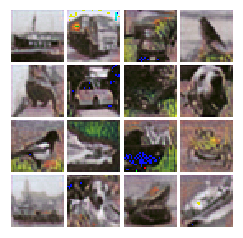

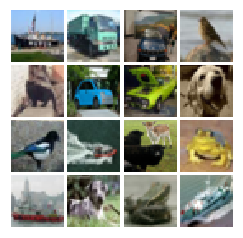

In [46]:
rand_indices = np.random.choice(np.arange(49000),batch_size)
minibatch = X_train[rand_indices]
samples_gray = sess.run(G_in,feed_dict = {x:minibatch})
fig = show_images2(samples_gray[:16])
plt.show()
samples = sess.run(G_sample,feed_dict = {x:minibatch})
fig = show_images(samples[:16])
plt.show()
fig = show_images(minibatch[:16])
plt.show()
            

In [ ]:
saver = tf.train.Saver()
saver.save(sess,'gan_model2')